In [ ]:
import pandas as pd
import numpy as np
import warnings
import scipy
from datetime import timedelta

In [ ]:
from pylab import rcParams
import statsmodels.api as sm
from statsmodels.tsa.stattools import adfuller

In [ ]:
import matplotlib.pyplot as plt
import seaborn as sns


In [ ]:
plt.style.use('fivethirtyeight')

In [ ]:
warnings.filterwarnings('ignore')

In [ ]:
train = pd.read_csv("train_1.csv")

In [ ]:
train_flattened = pd.melt(train[list(train.columns[-50:])+['Page']], id_vars='Page', var_name='date', value_name='Visits')
train_flattened['date'] = train_flattened['date'].astype('datetime64[ns]')
train_flattened['weekend'] = ((train_flattened.date.dt.dayofweek) // 5 == 1).astype(float)

In [ ]:
df_median = pd.DataFrame(train_flattened.groupby(['Page'])['Visits'].median())
df_median.columns = ['median']

# Average by page
df_mean = pd.DataFrame(train_flattened.groupby(['Page'])['Visits'].mean())
df_mean.columns = ['mean']

# Merging data
train_flattened = train_flattened.set_index('Page').join(df_mean).join(df_median)

In [ ]:
train_flattened.reset_index(drop=False,inplace=True)

In [ ]:
train_flattened['weekday'] = train_flattened['date'].apply(lambda x: x.weekday())

In [ ]:

train_flattened['year']=train_flattened.date.dt.year
train_flattened['month']=train_flattened.date.dt.month
train_flattened['day']=train_flattened.date.dt.day

In [ ]:
train_flattened.head()

,Page,date,Visits,weekend,mean,median,weekday,year,month,day
0,2NE1_zh.wikipedia.org_all-access_spider,2016-11-12,13.0,1.0,26.12,18.0,5,2016,11,12
1,2PM_zh.wikipedia.org_all-access_spider,2016-11-12,12.0,1.0,34.12,19.0,5,2016,11,12
2,3C_zh.wikipedia.org_all-access_spider,2016-11-12,6.0,1.0,8.44,4.0,5,2016,11,12
3,4minute_zh.wikipedia.org_all-access_spider,2016-11-12,38.0,1.0,16.04,14.0,5,2016,11,12
4,52_Hz_I_Love_You_zh.wikipedia.org_all-access_s...,2016-11-12,13.0,1.0,16.04,10.0,5,2016,11,12


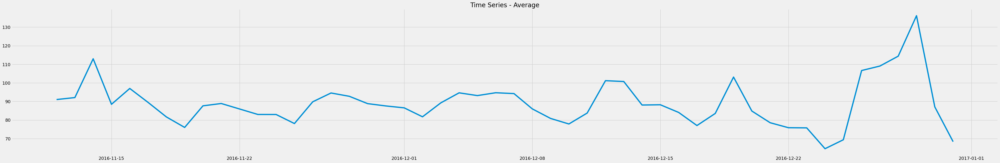

In [ ]:
plt.figure(figsize=(50, 8))
mean_group = train_flattened[['Page','date','Visits']].groupby(['date'])['Visits'].mean()
plt.plot(mean_group)
plt.title('Time Series - Average')
plt.show()

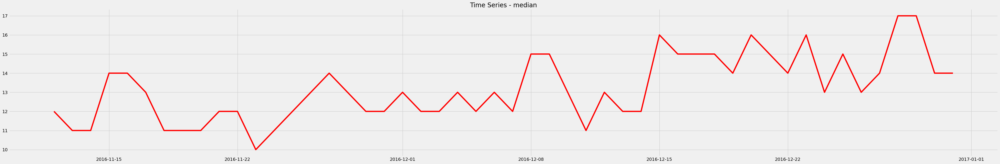

In [ ]:
plt.figure(figsize=(50, 8))
median_group = train_flattened[['Page','date','Visits']].groupby(['date'])['Visits'].median()
plt.plot(median_group, color = 'r')
plt.title('Time Series - median')
plt.show()

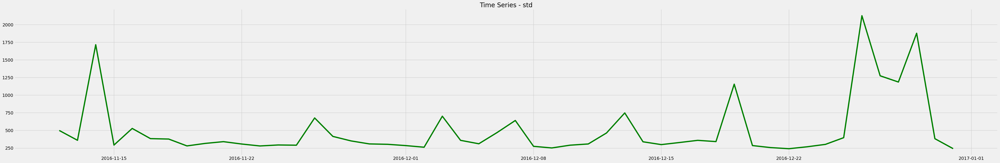

In [ ]:
plt.figure(figsize=(50, 8))
std_group = train_flattened[['Page','date','Visits']].groupby(['date'])['Visits'].std()
plt.plot(std_group, color = 'g')
plt.title('Time Series - std')
plt.show()

In [ ]:

train_flattened['month_num'] = train_flattened['month']
train_flattened['month'].replace('11','11 - November',inplace=True)
train_flattened['month'].replace('12','12 - December',inplace=True)

In [ ]:
train_flattened['weekday_num'] = train_flattened['weekday']
train_flattened['weekday'].replace(0,'01 - Monday',inplace=True)
train_flattened['weekday'].replace(1,'02 - Tuesday',inplace=True)
train_flattened['weekday'].replace(2,'03 - Wednesday',inplace=True)
train_flattened['weekday'].replace(3,'04 - Thursday',inplace=True)
train_flattened['weekday'].replace(4,'05 - Friday',inplace=True)
train_flattened['weekday'].replace(5,'06 - Saturday',inplace=True)
train_flattened['weekday'].replace(6,'07 - Sunday',inplace=True)

In [ ]:
train_group = train_flattened.groupby(["month", "weekday"])['Visits'].mean().reset_index()
train_group = train_group.pivot(index='weekday', columns='month', values='Visits')
train_group.sort_index(inplace=True)

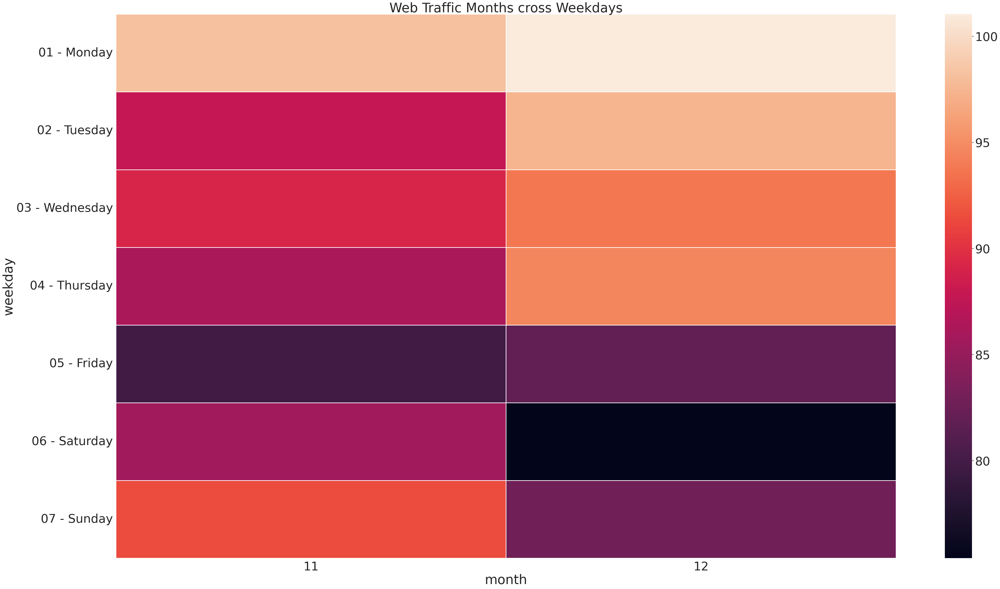

In [ ]:
sns.set(font_scale=3.5)


f, ax = plt.subplots(figsize=(50, 30))
sns.heatmap(train_group, annot=False, ax=ax, fmt="d", linewidths=2)
plt.title('Web Traffic Months cross Weekdays')
plt.show()

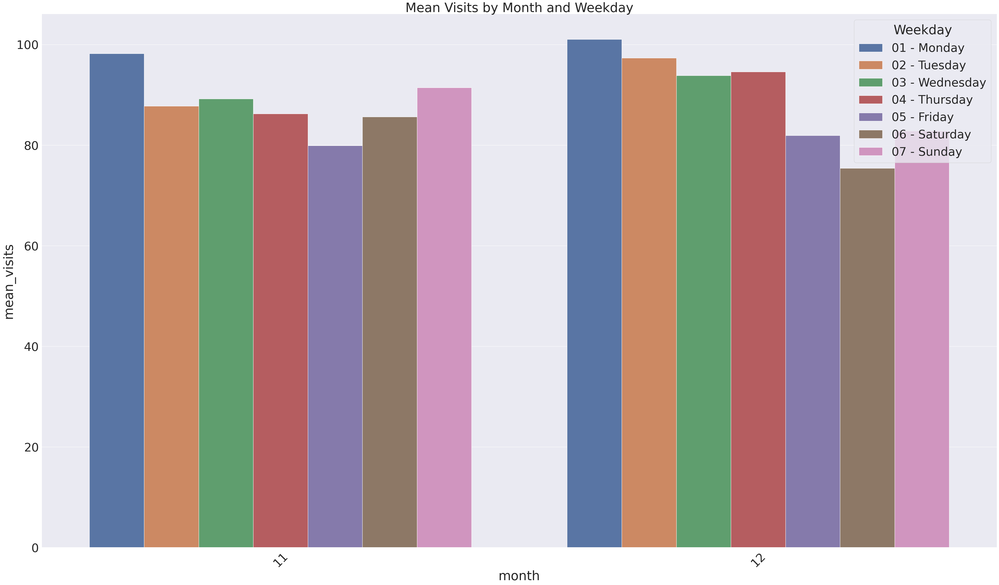

In [ ]:
train_group_plot = train_group.reset_index().melt(id_vars='weekday', var_name='month', value_name='mean_visits')
plt.figure(figsize=(50, 30))
sns.barplot(data=train_group_plot, x='month', y='mean_visits', hue='weekday')
plt.title('Mean Visits by Month and Weekday')
plt.xticks(rotation=45)
plt.legend(title='Weekday')
plt.show()


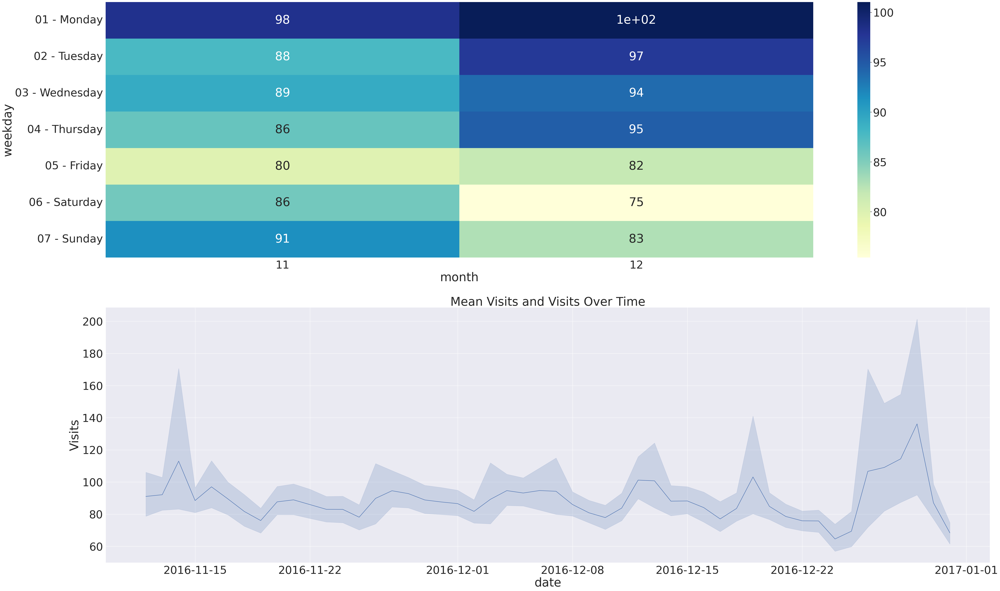

In [ ]:
fig, axes = plt.subplots(nrows=2, ncols=1, figsize=(50, 30))
sns.heatmap(train_group, annot=True, ax=axes[0], cmap="YlGnBu")
sns.lineplot(data=train_flattened, x='date', y='Visits', ax=axes[1])
plt.title("Mean Visits and Visits Over Time")
plt.tight_layout()
plt.show()


In [ ]:
times_series_means =  pd.DataFrame(mean_group).reset_index(drop=False)
times_series_means['weekday'] = times_series_means['date'].apply(lambda x: x.weekday())
times_series_means['Date_str'] = times_series_means['date'].apply(lambda x: str(x))
times_series_means[['year','month','day']] = times_series_means['Date_str'].str.split('-', expand=True)
date_staging = pd.DataFrame(times_series_means['day'].str.split(' ', expand=True).iloc[:, 0])
times_series_means['day'] = date_staging[0].astype(int)
times_series_means.drop('Date_str', axis=1, inplace=True)
times_series_means.head()

,date,Visits,weekday,year,month,day
0,2016-11-12,91.034719,5,2016,11,12
1,2016-11-13,92.101373,6,2016,11,13
2,2016-11-14,112.976613,0,2016,11,14
3,2016-11-15,88.472878,1,2016,11,15
4,2016-11-16,97.001612,2,2016,11,16


In [ ]:
from statsmodels.tsa.tsatools import lagmat

In [ ]:
times_series_means.reset_index(drop=True, inplace=True)

def lag_func(data, lag):
    X = lagmat(data["diff"], lag)
    lagged = data.copy()
    for c in range(1, lag+1):
        lagged[f"lag{c}"] = X[:, c-1]
    return lagged

def diff_creation(data):
    data["diff"] = np.nan
    data.iloc[1:, data.columns.get_loc("diff")] = (
        data.iloc[1:, 1].values - data.iloc[:len(data)-1, 1].values
    )
    return data

df_count = diff_creation(times_series_means)


lag = 7
lagged = lag_func(df_count, lag)
last_date = lagged['date'].max()

lagged.head()

,date,Visits,weekday,year,month,day,diff,lag1,lag2,lag3,lag4,lag5,lag6,lag7
0,2016-11-12,91.034719,5,2016,11,12,NaN,0.000000,0.000000,0.000000,0.0,0.0,0.0,0.0
1,2016-11-13,92.101373,6,2016,11,13,1.066654,NaN,0.000000,0.000000,0.0,0.0,0.0,0.0
2,2016-11-14,112.976613,0,2016,11,14,20.875240,1.066654,NaN,0.000000,0.0,0.0,0.0,0.0
3,2016-11-15,88.472878,1,2016,11,15,-24.503735,20.875240,1.066654,NaN,0.0,0.0,0.0,0.0
4,2016-11-16,97.001612,2,2016,11,16,8.528734,-24.503735,20.875240,1.066654,NaN,0.0,0.0,0.0


In [ ]:
lagged_basic = lagged[['date','Visits','weekday']]
lagged_basic_tr   = lagged_basic[lagged_basic['date'] < last_date]
lagged_basic_pred = lagged_basic[lagged_basic['date'] >= last_date]
lagged_basic_pred.drop('Visits',inplace=True,axis=1)

In [ ]:
prediction_by_days = pd.DataFrame(lagged_basic.groupby(['weekday'])['Visits'].mean())
prediction_by_days.reset_index(drop=False,inplace=True)
prediction_by_days

,weekday,Visits
0,0,99.829533
1,1,93.234665
2,2,91.839282
3,3,92.188886
4,4,81.340970
5,5,79.249958
6,6,86.525669


In [ ]:
lagged_basic_pred

,date,weekday
49,2016-12-31,5


In [ ]:
basic_pred = pd.merge(lagged_basic_pred,prediction_by_days,on='weekday')
basic_approach = pd.concat([lagged_basic_tr,basic_pred])

In [ ]:
half_period = pd.Timedelta(days=30)  
plot_basic = np.array(basic_approach[basic_approach['date'] >= (last_date - half_period)].sort_values(by='date').Visits)

In [ ]:
basic_approach

,date,Visits,weekday
0,2016-11-12,91.034719,5
1,2016-11-13,92.101373,6
2,2016-11-14,112.976613,0
3,2016-11-15,88.472878,1
4,2016-11-16,97.001612,2
5,2016-11-17,89.502318,3
6,2016-11-18,81.687424,4
7,2016-11-19,76.027201,5
8,2016-11-20,87.652086,6
9,2016-11-21,88.905577,0


In [ ]:
plot_basic

array([ 86.56248742,  81.75327028,  89.24738536,  94.6478392 ,
        93.16710235,  94.69957772,  94.24170521,  86.01586664,
        80.87020293,  77.8842063 ,  83.77023499, 101.19060995,
       100.74477912,  88.08714859,  88.2235601 ,  84.09863673,
        77.04612916,  83.55557785, 103.12948487,  84.85594069,
        78.5624624 ,  75.87354709,  75.78641555,  64.5748647 ,
        69.38762019, 106.6555867 , 109.06944166, 114.38426111,
       136.16032826,  87.07341468,  79.24995828])

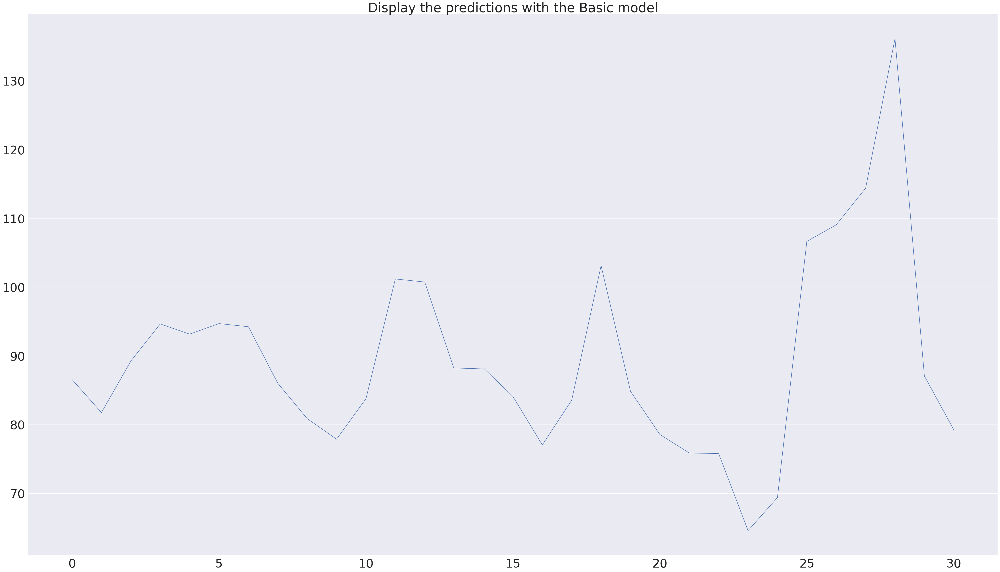

In [ ]:
plt.figure(figsize=(50, 30))
plt.plot(plot_basic)
plt.title('Display the predictions with the Basic model')
plt.show()

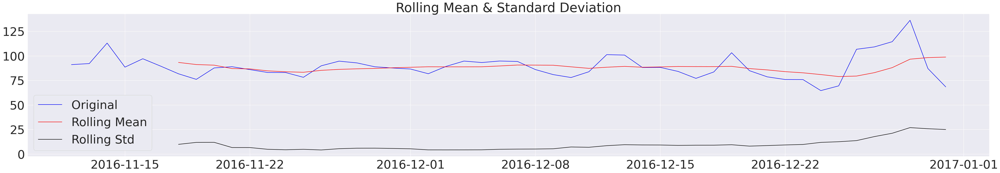

Results of Dickey-Fuller Test:
Test Statistic                -5.875567e+00
p-value                        3.165540e-07
#Lags Used                     3.000000e+00
Number of Observations Used    4.600000e+01
Critical Value (1%)           -3.581258e+00
Critical Value (5%)           -2.926785e+00
Critical Value (10%)          -2.601541e+00
dtype: float64


In [ ]:
import pandas as pd
import matplotlib.pyplot as plt
import statsmodels.api as sm

df_date_index = times_series_means[['date', 'Visits']].set_index('date')

def test_stationarity(timeseries):
    plt.figure(figsize=(50, 8))

    
    rolmean = timeseries['Visits'].rolling(window=7).mean()
    rolstd = timeseries['Visits'].rolling(window=7).std()

   
    orig = plt.plot(timeseries['Visits'], color='blue', label='Original')
    mean = plt.plot(rolmean, color='red', label='Rolling Mean')
    std = plt.plot(rolstd, color='black', label='Rolling Std')
    plt.legend(loc='best')
    plt.title('Rolling Mean & Standard Deviation')
    plt.show(block=False)

   
    print('Results of Dickey-Fuller Test:')
    dftest = sm.tsa.adfuller(timeseries['Visits'], autolag='AIC')
    dfoutput = pd.Series(dftest[0:4], index=['Test Statistic', 'p-value', '#Lags Used', 'Number of Observations Used'])
    for key, value in dftest[4].items():
        dfoutput['Critical Value (%s)' % key] = value
    print(dfoutput)

test_stationarity(df_date_index)


In [ ]:
import statsmodels.api as sm
import matplotlib.pyplot as plt
from matplotlib import rcParams


decomposition = sm.tsa.seasonal_decompose(df_date_index['Visits'], model='multiplicative', period=7)


trend = decomposition.trend
seasonal = decomposition.seasonal
residual = decomposition.resid


rcParams['figure.figsize'] = 50, 30

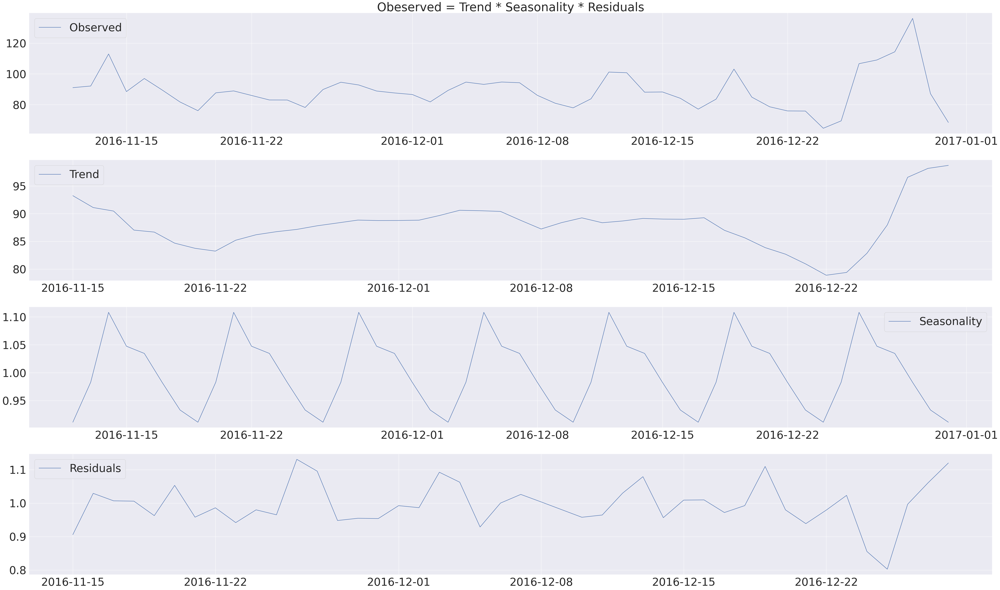

In [ ]:
plt.subplot(411)
plt.title('Obeserved = Trend * Seasonality * Residuals')
plt.plot(df_date_index, label='Observed')
plt.legend(loc='best')
plt.subplot(412)
plt.plot(trend, label='Trend')
plt.legend(loc='best')
plt.subplot(413)
plt.plot(seasonal,label='Seasonality')
plt.legend(loc='best')
plt.subplot(414)
plt.plot(residual, label='Residuals')
plt.legend(loc='best')
plt.tight_layout()
plt.show()

In [ ]:
import statsmodels.api as sm
import matplotlib.pyplot as plt
from matplotlib import rcParams

decomposition = sm.tsa.seasonal_decompose(df_date_index['Visits'], model='additive', period=7)


trend = decomposition.trend
seasonal = decomposition.seasonal
residual = decomposition.resid


rcParams['figure.figsize'] = 40, 20

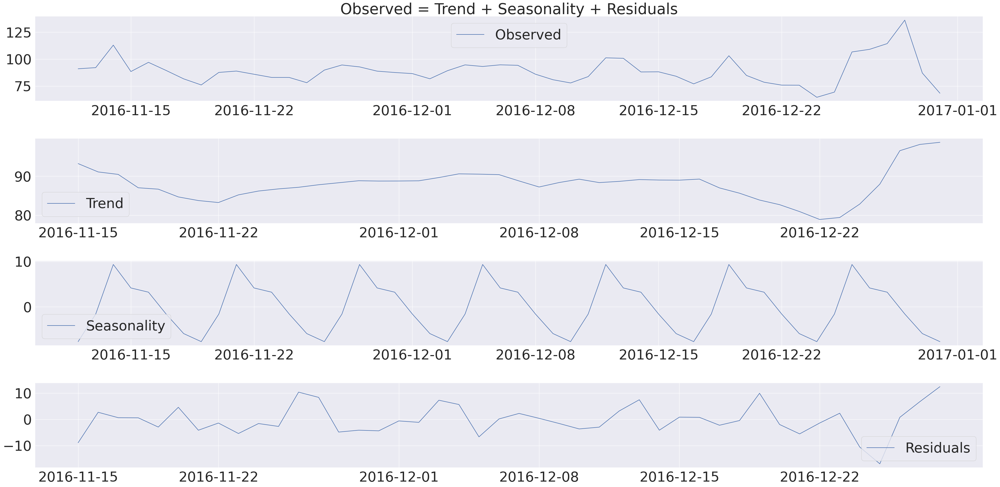

In [ ]:
plt.subplot(411)
plt.title('Observed = Trend + Seasonality + Residuals')
plt.plot(df_date_index, label='Observed')
plt.legend(loc='best')
plt.subplot(412)
plt.plot(trend, label='Trend')
plt.legend(loc='best')
plt.subplot(413)
plt.plot(seasonal,label='Seasonality')
plt.legend(loc='best')
plt.subplot(414)
plt.plot(residual, label='Residuals')
plt.legend(loc='best')
plt.tight_layout()
plt.show()

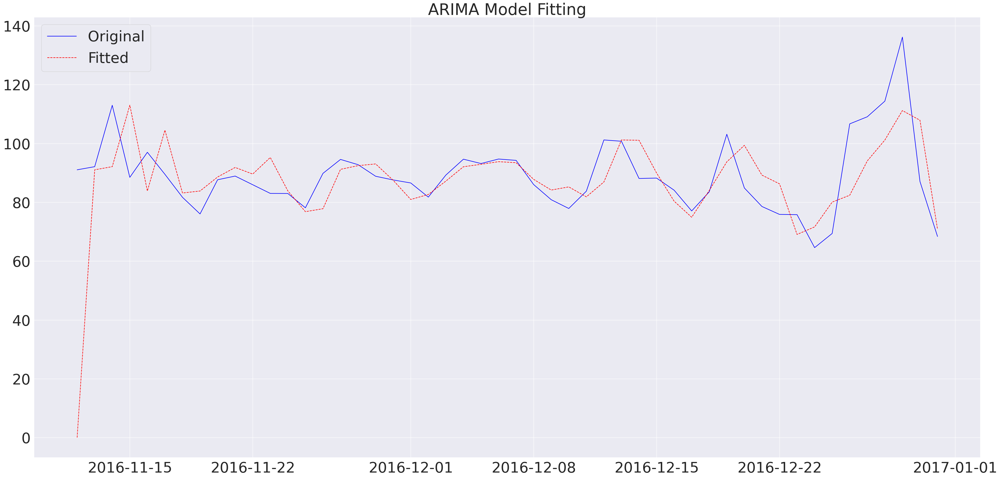

In [ ]:
import pandas as pd
import matplotlib.pyplot as plt
from statsmodels.tsa.arima.model import ARIMA  


model = ARIMA(df_date_index['Visits'], order=(7, 1, 0)) 
results_AR1 = model.fit()


plt.figure(figsize=(40, 20))
plt.plot(df_date_index['Visits'], color='blue', label='Original')
plt.plot(results_AR1.fittedvalues, color='red', label='Fitted', linestyle='--')
plt.title('ARIMA Model Fitting')
plt.legend(loc='upper left')
plt.show()


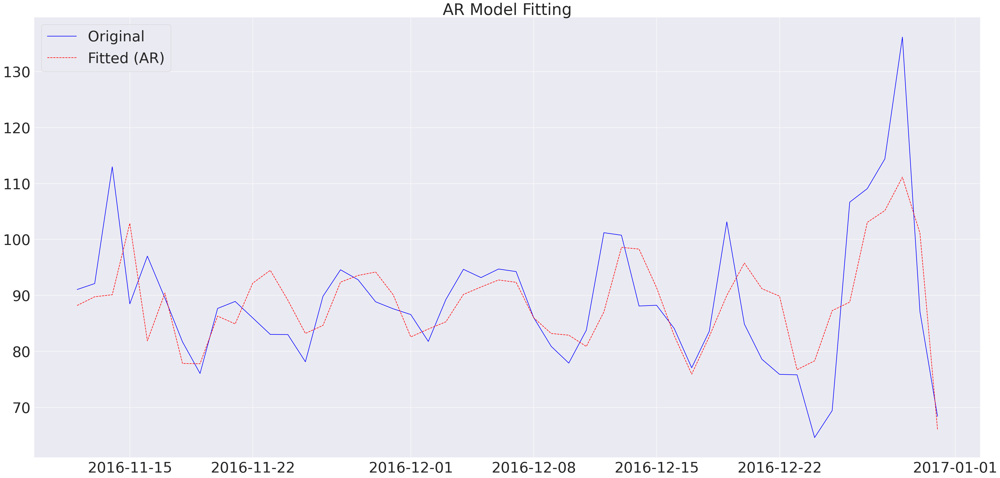

In [ ]:
p = 7   
model_AR = ARIMA(df_date_index['Visits'], order=(p, 0, 0))
results_AR2 = model_AR.fit()


plt.figure(figsize=(40, 20))
plt.plot(df_date_index['Visits'], color='blue', label='Original')
plt.plot(results_AR2.fittedvalues, color='red', label='Fitted (AR)', linestyle='--')
plt.title('AR Model Fitting')
plt.legend(loc='upper left')
plt.show()

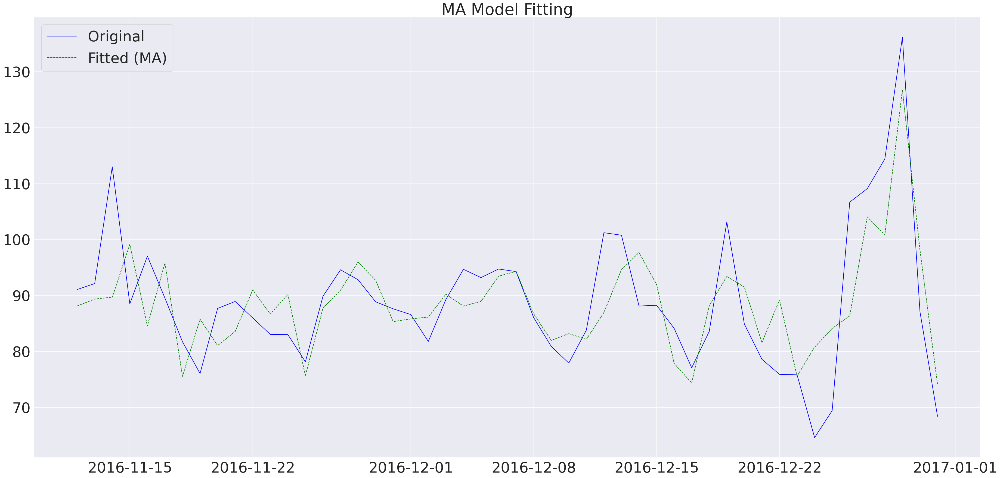

In [ ]:
q = 7  
model_MA = ARIMA(df_date_index['Visits'], order=(0, 0, q))
results_MA = model_MA.fit()

plt.figure(figsize=(40, 20))
plt.plot(df_date_index['Visits'], color='blue', label='Original')
plt.plot(results_MA.fittedvalues, color='green', label='Fitted (MA)', linestyle='--')
plt.title('MA Model Fitting')
plt.legend(loc='upper left')
plt.show()

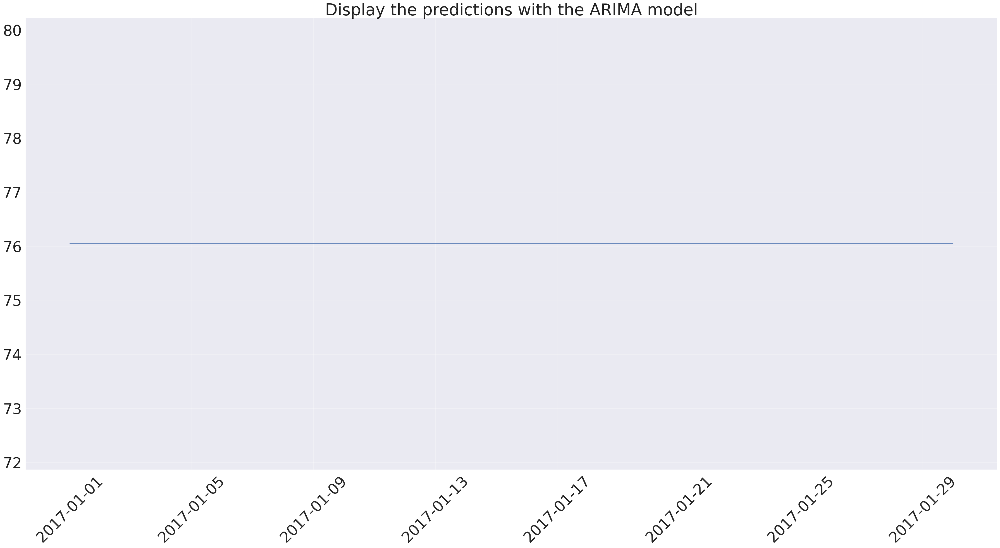

In [ ]:
future_dates = pd.date_range(start=pd.to_datetime(last_date) + pd.Timedelta(days=1), periods=30, freq='D')

forecast = results_AR1.forecast(steps=30)[0]
plt.figure(figsize=(40, 20))


forecast_df = pd.DataFrame({'Forecast': forecast}, index=future_dates)

plt.plot(forecast_df['Forecast'])
plt.title('Display the predictions with the ARIMA model')
plt.grid(True, alpha=0.3)
plt.xticks(rotation=45)
plt.show()

In [ ]:
from statsmodels.graphics.tsaplots import plot_acf, plot_pacf

<Figure size 1200x400 with 0 Axes>

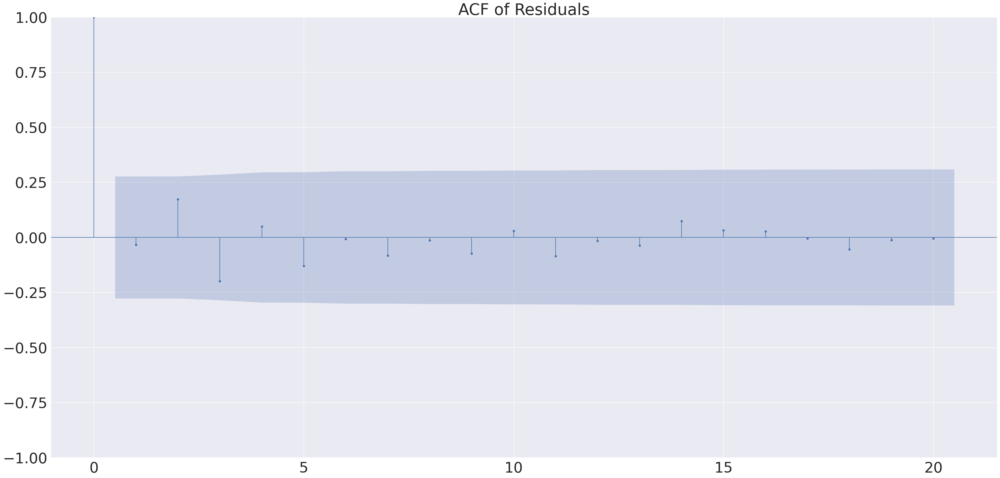

<Figure size 1200x400 with 0 Axes>

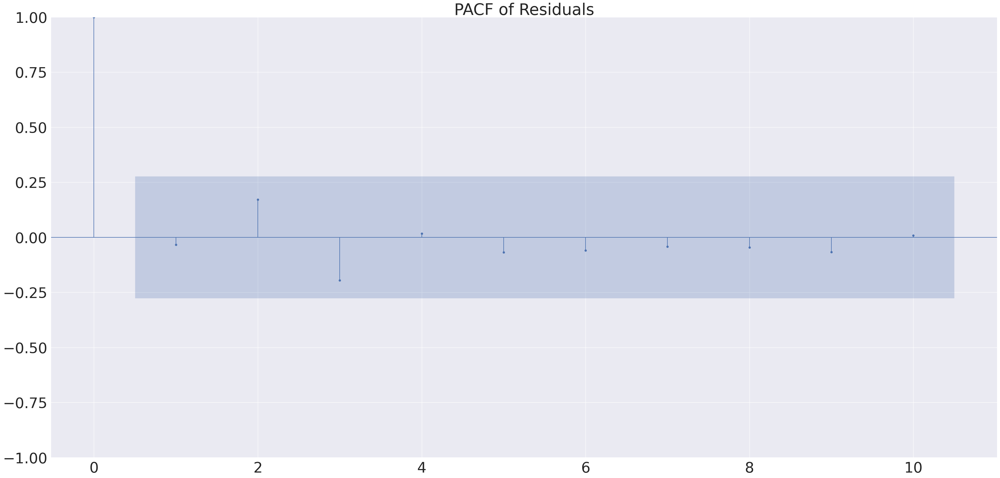

In [ ]:
residuals = results_AR1.resid


plt.figure(figsize=(12, 4))
plot_acf(residuals, lags=20)
plt.title('ACF of Residuals')
plt.show()


plt.figure(figsize=(12, 4))
plot_pacf(residuals, lags=10)
plt.title('PACF of Residuals')
plt.show()

<Figure size 1200x400 with 0 Axes>

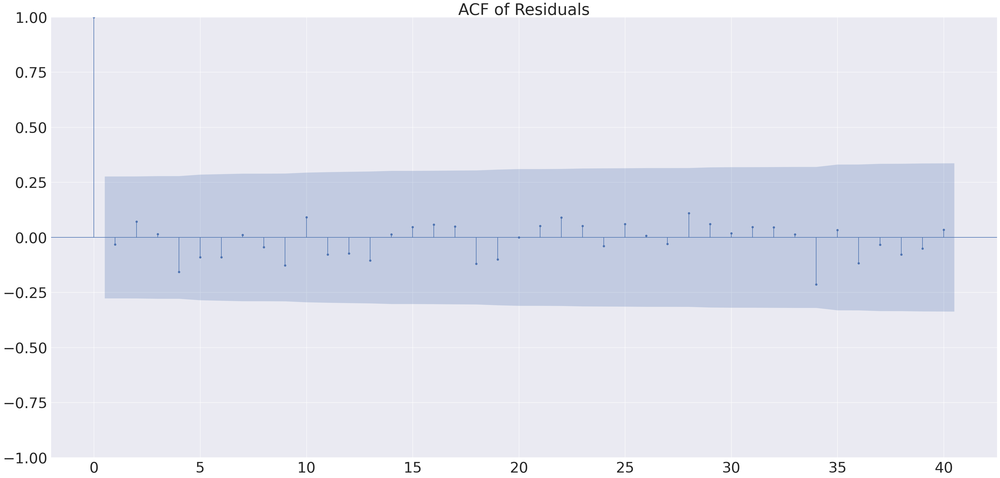

<Figure size 1200x400 with 0 Axes>

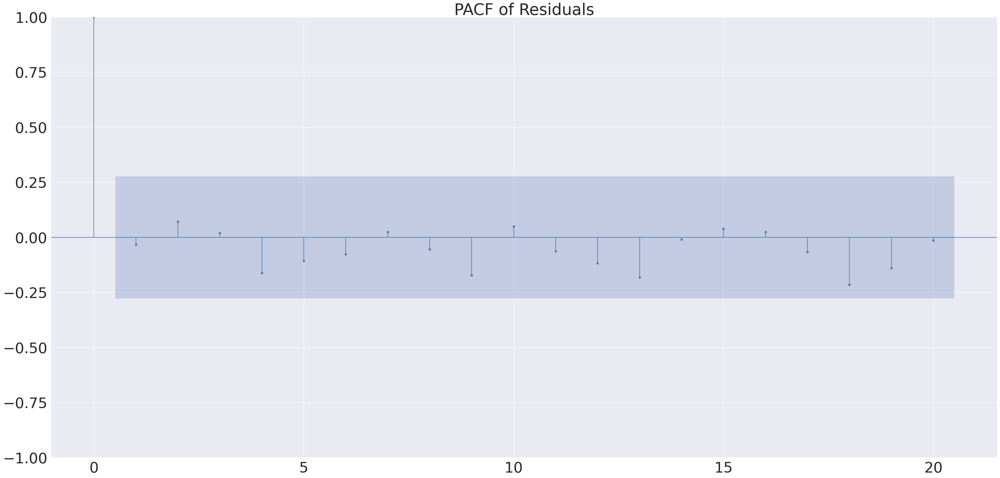

In [ ]:
residuals = results_AR2.resid


plt.figure(figsize=(12, 4))
plot_acf(residuals, lags=40)
plt.title('ACF of Residuals')
plt.show()


plt.figure(figsize=(12, 4))
plot_pacf(residuals, lags=20)
plt.title('PACF of Residuals')
plt.show()

<Figure size 1200x400 with 0 Axes>

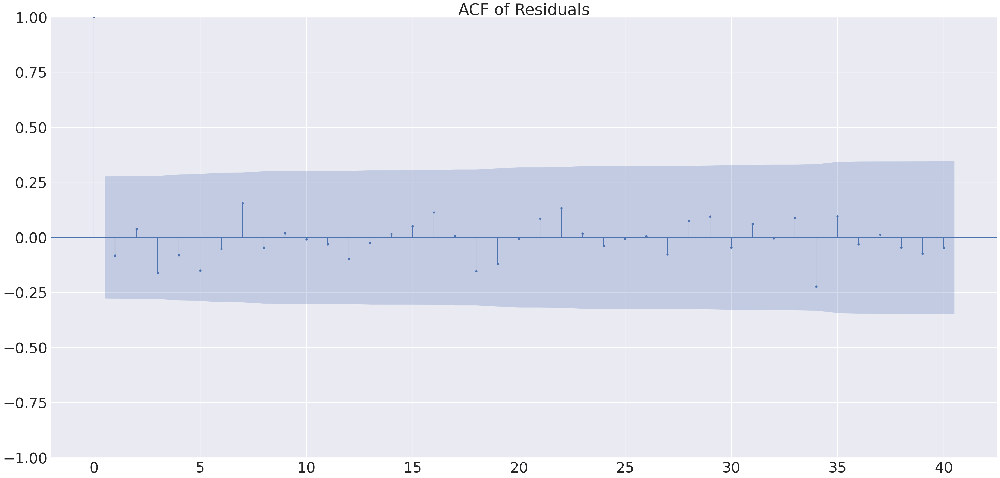

<Figure size 1200x400 with 0 Axes>

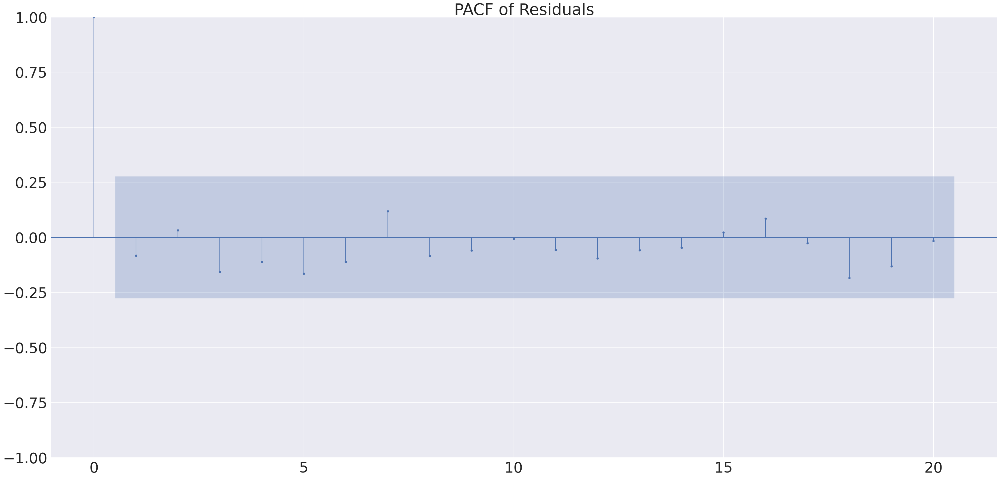

In [ ]:
residuals = results_MA.resid


plt.figure(figsize=(12, 4))
plot_acf(residuals, lags=40)
plt.title('ACF of Residuals')
plt.show()

plt.figure(figsize=(12, 4))
plot_pacf(residuals, lags=20)
plt.title('PACF of Residuals')
plt.show()

In [ ]:
from sklearn.metrics import mean_squared_error, mean_absolute_error, r2_score


predictions = results_AR1.predict()


mse = mean_squared_error(df_date_index['Visits'], predictions)
rmse = np.sqrt(mse)
mae = mean_absolute_error(df_date_index['Visits'], predictions)
r2 = r2_score(df_date_index['Visits'], predictions)

print(f'MSE: {mse}')
print(f'RMSE: {rmse}')
print(f'MAE: {mae}')
print(f'R2 Score: {r2}')

MSE: 268.57549948308986
RMSE: 16.388273230669846
MAE: 9.005280146782535
R2 Score: -0.7510449697250987


In [ ]:
from sklearn.metrics import mean_squared_error, mean_absolute_error, r2_score


predictions = results_AR2.predict()


mse = mean_squared_error(df_date_index['Visits'], predictions)
rmse = np.sqrt(mse)
mae = mean_absolute_error(df_date_index['Visits'], predictions)
r2 = r2_score(df_date_index['Visits'], predictions)

print(f'MSE: {mse}')
print(f'RMSE: {rmse}')
print(f'MAE: {mae}')
print(f'R2 Score: {r2}')

MSE: 83.27049892634281
RMSE: 9.125267060549122
MAE: 6.711389872293958
R2 Score: 0.4570972089706479


In [ ]:
from sklearn.metrics import mean_squared_error, mean_absolute_error, r2_score


predictions = results_MA.predict()


mse = mean_squared_error(df_date_index['Visits'], predictions)
rmse = np.sqrt(mse)
mae = mean_absolute_error(df_date_index['Visits'], predictions)
r2 = r2_score(df_date_index['Visits'], predictions)

print(f'MSE: {mse}')
print(f'RMSE: {rmse}')
print(f'MAE: {mae}')
print(f'R2 Score: {r2}')

MSE: 68.27663387575468
RMSE: 8.26296761918832
MAE: 6.453306362110233
R2 Score: 0.5548534526492428


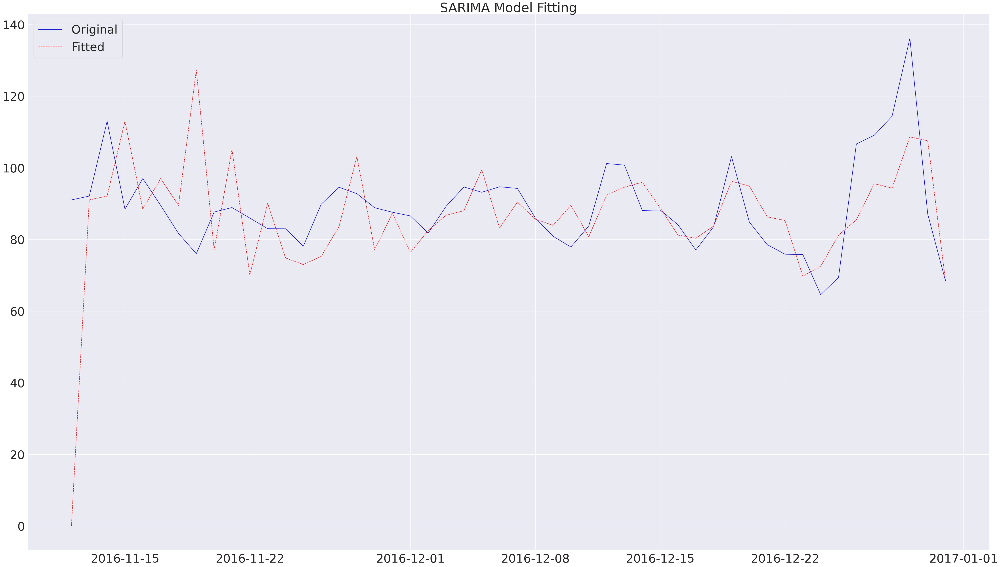

In [ ]:
import pandas as pd
import matplotlib.pyplot as plt
from statsmodels.tsa.statespace.sarimax import SARIMAX  

order = (6, 1, 0) 
seasonal_order = (1, 1, 1, 7)  

model = SARIMAX(df_date_index['Visits'], order=order, seasonal_order=seasonal_order)
results_SARIMA = model.fit()

plt.figure(figsize=(50, 30))
plt.plot(df_date_index['Visits'], color='blue', label='Original')
plt.plot(results_SARIMA.fittedvalues, color='red', label='Fitted', linestyle='--')
plt.title('SARIMA Model Fitting')
plt.legend(loc='upper left')
plt.show()


In [ ]:
from sklearn.metrics import mean_squared_error, mean_absolute_error, r2_score


predictions = results_SARIMA.predict()


mse = mean_squared_error(df_date_index['Visits'], predictions)
rmse = np.sqrt(mse)
mae = mean_absolute_error(df_date_index['Visits'], predictions)
r2 = r2_score(df_date_index['Visits'], predictions)

print(f'MSE: {mse}')
print(f'RMSE: {rmse}')
print(f'MAE: {mae}')
print(f'R2 Score: {r2}')

MSE: 338.3190548176073
RMSE: 18.393451411238928
MAE: 11.50622897731918
R2 Score: -1.205755477475416


In [ ]:
aic = results_SARIMA.aic
bic = results_SARIMA.bic
rmse = np.sqrt(np.mean((df_date_index['Visits'] - results_SARIMA.fittedvalues) ** 2))
mae = np.mean(np.abs(df_date_index['Visits'] - results_SARIMA.fittedvalues))

print(f"AIC: {aic}, BIC: {bic}, RMSE: {rmse}, MAE: {mae}")

AIC: 338.3630222746275, BIC: 354.0020488391778, RMSE: 18.393451411238928, MAE: 11.50622897731918


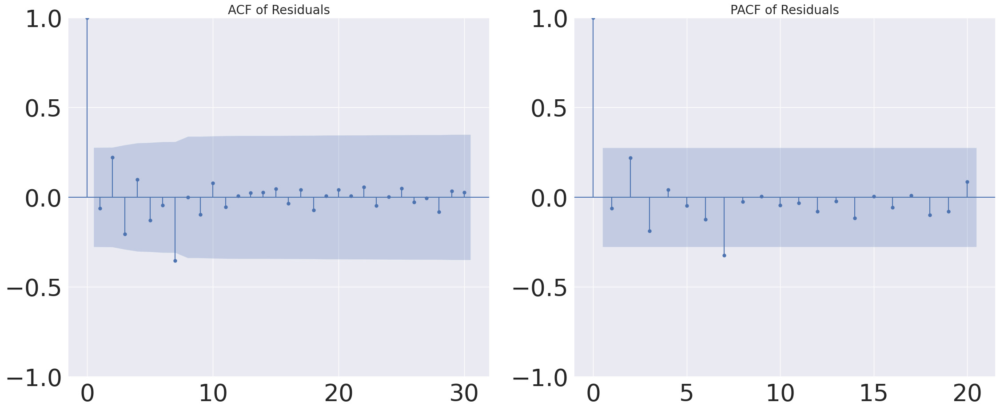

In [ ]:
residuals = results_SARIMA.resid


fig, axes = plt.subplots(1, 2, figsize=(24, 10))


plot_acf(residuals, lags=30, ax=axes[0])
axes[0].set_title('ACF of Residuals', fontsize=20)


plot_pacf(residuals, lags=20, ax=axes[1])
axes[1].set_title('PACF of Residuals', fontsize=20)

plt.show()

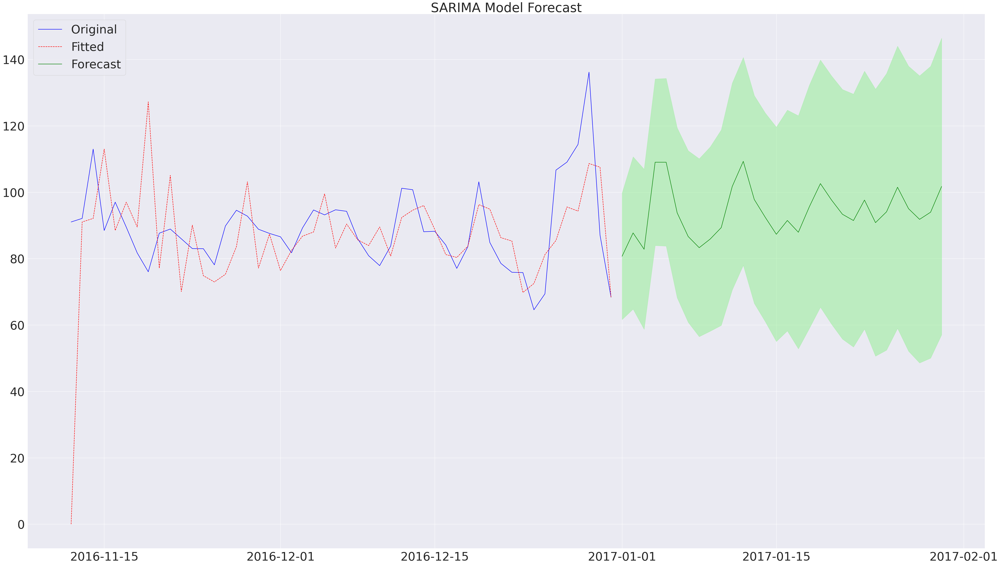

In [ ]:
n_steps_ahead = 30  
forecast = results_SARIMA.get_forecast(steps=n_steps_ahead)
forecast_index = pd.date_range(start=df_date_index.index[-1] + pd.Timedelta(days=1), periods=n_steps_ahead, freq='D')
forecast_values = forecast.predicted_mean
confidence_intervals = forecast.conf_int()


plt.figure(figsize=(50, 30))
plt.plot(df_date_index['Visits'], color='blue', label='Original')
plt.plot(results_SARIMA.fittedvalues, color='red', label='Fitted', linestyle='--')
plt.plot(forecast_index, forecast_values, color='green', label='Forecast', linestyle='-')
plt.fill_between(forecast_index, confidence_intervals.iloc[:, 0], confidence_intervals.iloc[:, 1], color='lightgreen', alpha=0.5)
plt.title('SARIMA Model Forecast')
plt.legend(loc='upper left')
plt.show()

In [ ]:
import statsmodels.api as sm


decomposition = sm.tsa.seasonal_decompose(df_date_index['Visits'], model='additive', period=7)
seasonal = decomposition.seasonal


df_date_index['Visits_detrended'] = df_date_index['Visits'] - seasonal


In [ ]:
import statsmodels.api as sm
import matplotlib.pyplot as plt
from matplotlib import rcParams


decomposition = sm.tsa.seasonal_decompose(df_date_index['Visits_detrended'], model='additive', period=7)


trend = decomposition.trend
seasonal = decomposition.seasonal
residual = decomposition.resid


rcParams['figure.figsize'] = 50, 30

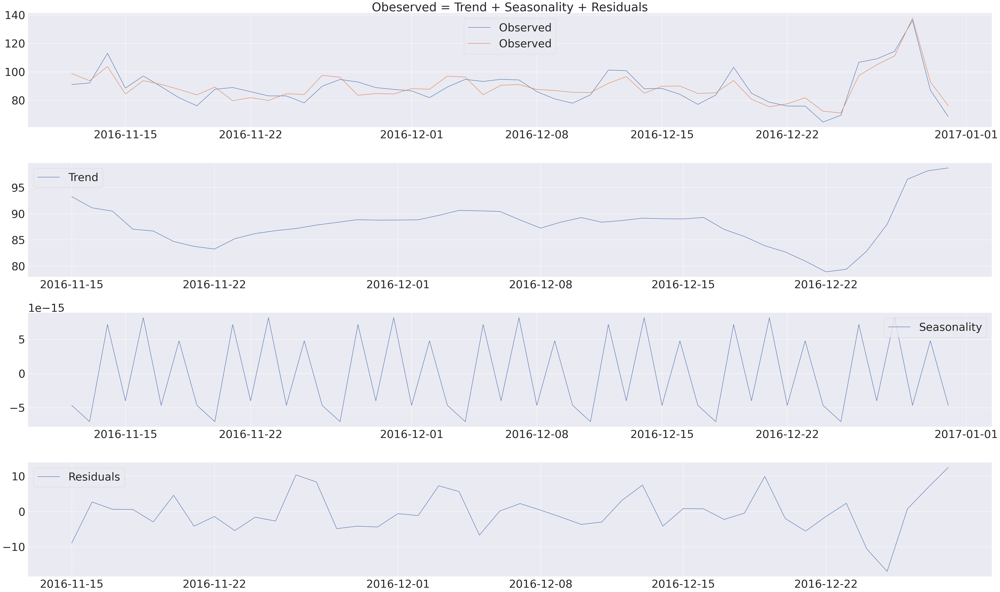

In [ ]:
plt.subplot(411)
plt.title('Obeserved = Trend + Seasonality + Residuals')
plt.plot(df_date_index, label='Observed')
plt.legend(loc='best')
plt.subplot(412)
plt.plot(trend, label='Trend')
plt.legend(loc='best')
plt.subplot(413)
plt.plot(seasonal,label='Seasonality')
plt.legend(loc='best')
plt.subplot(414)
plt.plot(residual, label='Residuals')
plt.legend(loc='best')
plt.tight_layout()
plt.show()

In [ ]:

df_date_index['Visits_diff'] = df_date_index['Visits'] - df_date_index['Visits'].shift(7)  
df_date_index.dropna(inplace=True) 


In [ ]:
import statsmodels.api as sm
import matplotlib.pyplot as plt
from matplotlib import rcParams

decomposition = sm.tsa.seasonal_decompose(df_date_index['Visits_diff'], model='additive', period=7)


trend = decomposition.trend
seasonal = decomposition.seasonal
residual = decomposition.resid


rcParams['figure.figsize'] = 50, 30

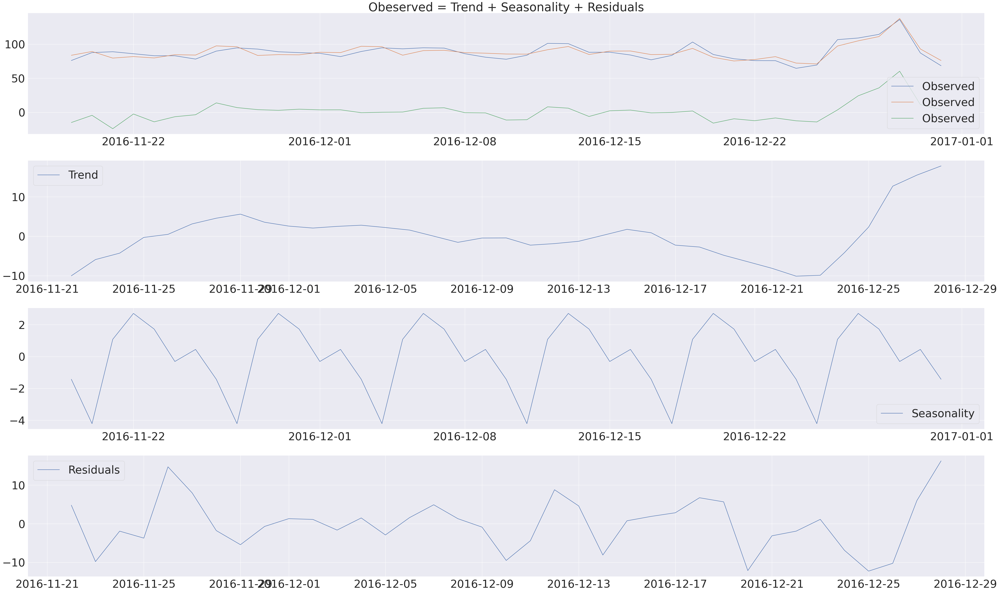

In [ ]:
plt.subplot(411)
plt.title('Obeserved = Trend + Seasonality + Residuals')
plt.plot(df_date_index, label='Observed')
plt.legend(loc='best')
plt.subplot(412)
plt.plot(trend, label='Trend')
plt.legend(loc='best')
plt.subplot(413)
plt.plot(seasonal,label='Seasonality')
plt.legend(loc='best')
plt.subplot(414)
plt.plot(residual, label='Residuals')
plt.legend(loc='best')
plt.tight_layout()
plt.show()

In [ ]:

window_size = 7 
df_date_index['Visits_moving_avg'] = df_date_index['Visits'].rolling(window=window_size).mean()


df_date_index['Visits_detrended'] = df_date_index['Visits'] - df_date_index['Visits_moving_avg']


In [ ]:
df_date_index.dropna(subset=['Visits_detrended'], inplace=True)

In [ ]:
import statsmodels.api as sm
import matplotlib.pyplot as plt
from matplotlib import rcParams


decomposition = sm.tsa.seasonal_decompose(df_date_index['Visits_detrended'], model='additive', period=7)


trend = decomposition.trend
seasonal = decomposition.seasonal
residual = decomposition.resid


rcParams['figure.figsize'] = 50, 30

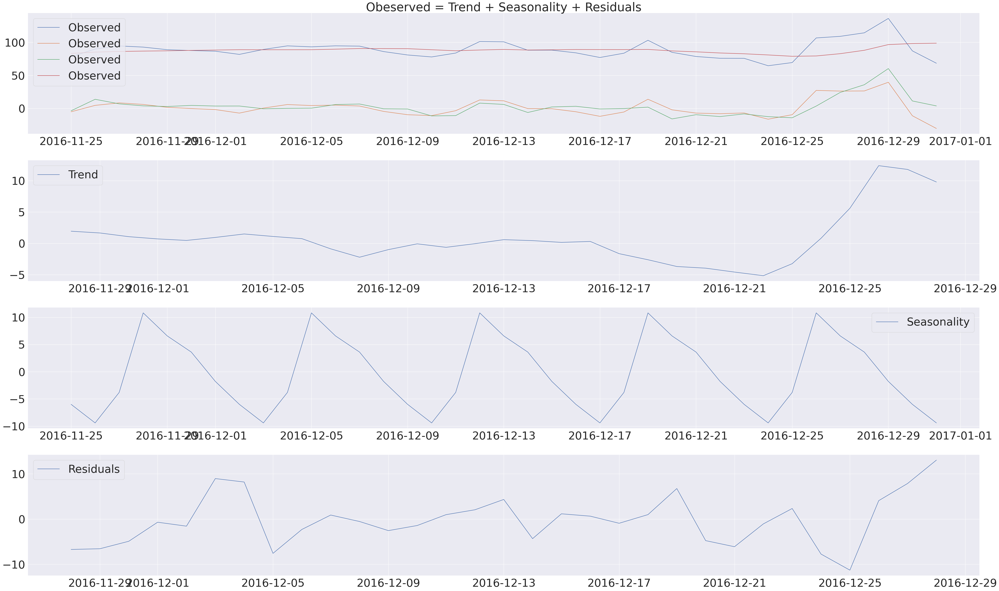

In [ ]:
plt.subplot(411)
plt.title('Obeserved = Trend + Seasonality + Residuals')
plt.plot(df_date_index, label='Observed')
plt.legend(loc='best')
plt.subplot(412)
plt.plot(trend, label='Trend')
plt.legend(loc='best')
plt.subplot(413)
plt.plot(seasonal,label='Seasonality')
plt.legend(loc='best')
plt.subplot(414)
plt.plot(residual, label='Residuals')
plt.legend(loc='best')
plt.tight_layout()
plt.show()

In [ ]:
import statsmodels.api as sm


frac = 0.5  
loess = sm.nonparametric.lowess(df_date_index['Visits'], df_date_index.index, frac=frac)
df_date_index['Visits_loess'] = loess[:, 1]


df_date_index['Visits_deseasoned'] = df_date_index['Visits'] - df_date_index['Visits_loess']


In [ ]:
import statsmodels.api as sm
import matplotlib.pyplot as plt
from matplotlib import rcParams


decomposition = sm.tsa.seasonal_decompose(df_date_index['Visits_deseasoned'], model='additive', period=7)


trend = decomposition.trend
seasonal = decomposition.seasonal
residual = decomposition.resid


rcParams['figure.figsize'] = 50, 30

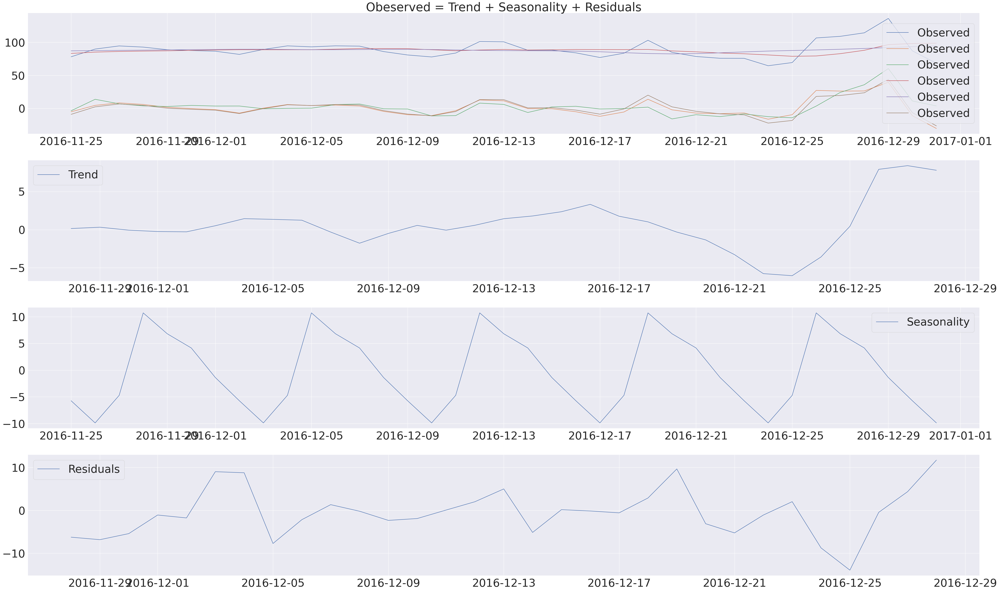

In [ ]:
plt.subplot(411)
plt.title('Obeserved = Trend + Seasonality + Residuals')
plt.plot(df_date_index, label='Observed')
plt.legend(loc='best')
plt.subplot(412)
plt.plot(trend, label='Trend')
plt.legend(loc='best')
plt.subplot(413)
plt.plot(seasonal,label='Seasonality')
plt.legend(loc='best')
plt.subplot(414)
plt.plot(residual, label='Residuals')
plt.legend(loc='best')
plt.tight_layout()
plt.show()

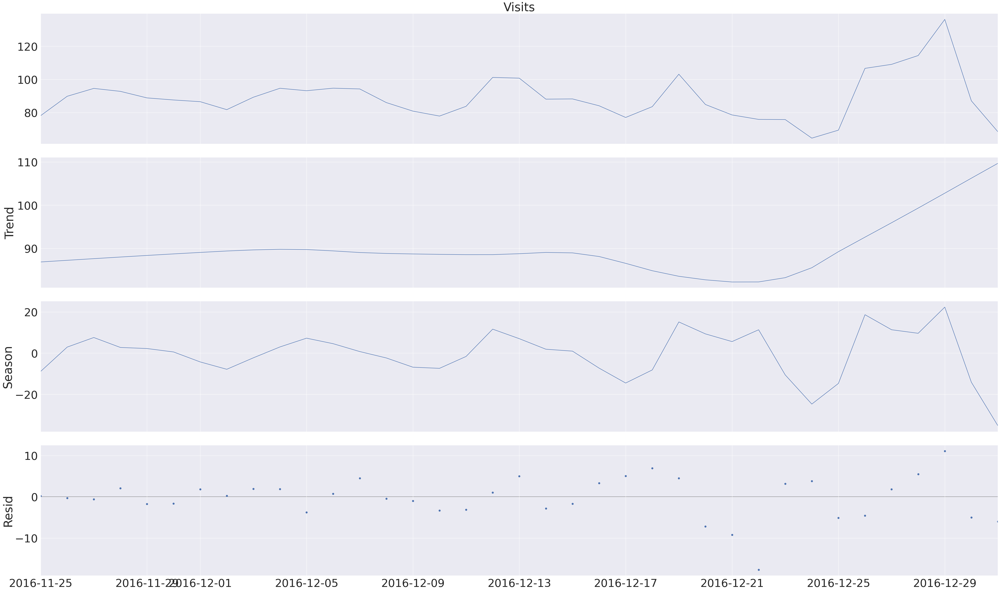

In [ ]:
from statsmodels.tsa.seasonal import STL


stl = STL(df_date_index['Visits'], seasonal=7)
result = stl.fit()


result.plot()
plt.show()


In [ ]:
df_date_index['Visits_log'] = np.log(df_date_index['Visits'])


decomposition = sm.tsa.seasonal_decompose(df_date_index['Visits_log'], model='additive', period=7)

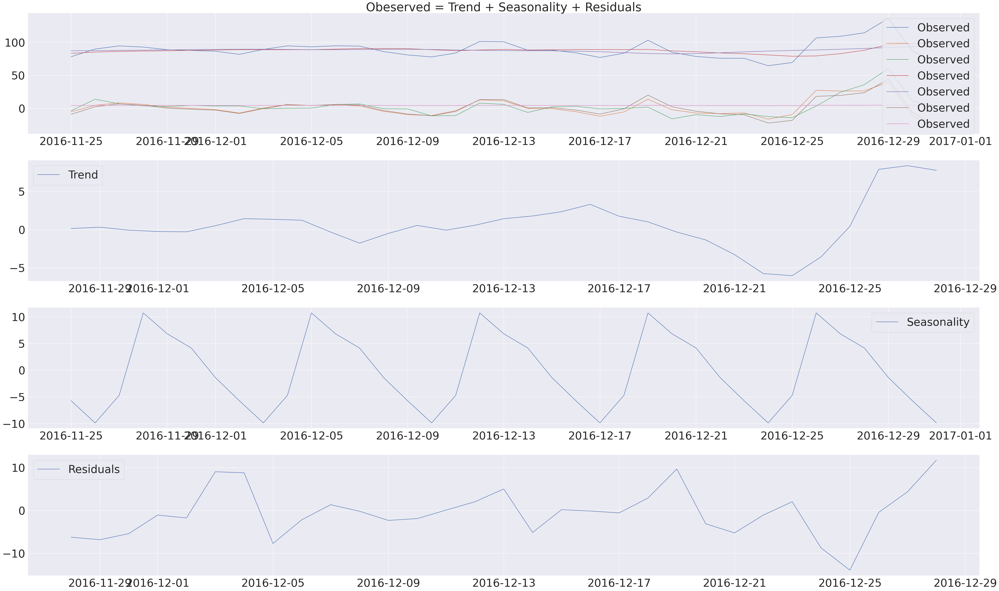

In [ ]:
plt.subplot(411)
plt.title('Obeserved = Trend + Seasonality + Residuals')
plt.plot(df_date_index, label='Observed')
plt.legend(loc='best')
plt.subplot(412)
plt.plot(trend, label='Trend')
plt.legend(loc='best')
plt.subplot(413)
plt.plot(seasonal,label='Seasonality')
plt.legend(loc='best')
plt.subplot(414)
plt.plot(residual, label='Residuals')
plt.legend(loc='best')
plt.tight_layout()
plt.show()

In [ ]:
result = adfuller(df_date_index['Visits'])
print('ADF Statistic:', result[0])
print('p-value:', result[1])

ADF Statistic: -5.738625370115852
p-value: 6.351693247927157e-07


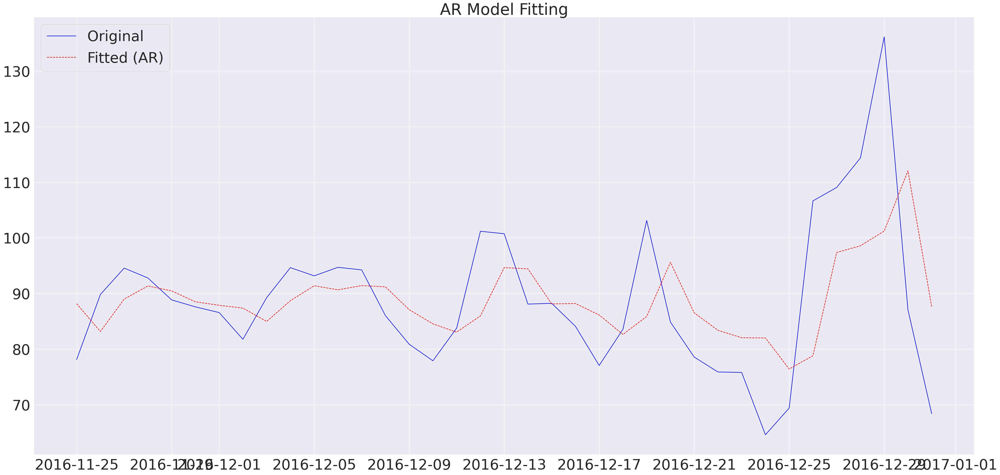

In [ ]:
p = 7  
model_AR1 = ARIMA(df_date_index['Visits'], order=(1, 0, 0)) #AR(1)
results_AR2 = model_AR1.fit()


plt.figure(figsize=(40, 20))
plt.plot(df_date_index['Visits'], color='blue', label='Original')
plt.plot(results_AR2.fittedvalues, color='red', label='Fitted (AR)', linestyle='--')
plt.title('AR Model Fitting')
plt.legend(loc='upper left')
plt.show()

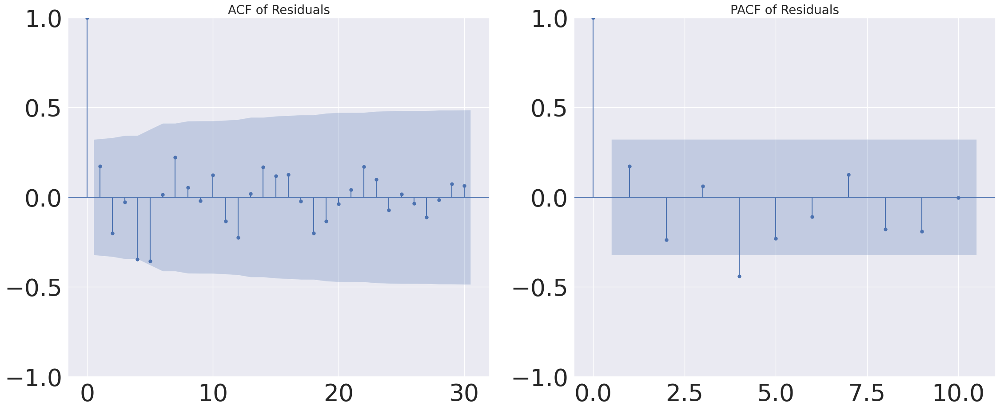

In [ ]:
residuals = results_AR2.resid


fig, axes = plt.subplots(1, 2, figsize=(24, 10))


plot_acf(residuals, lags=30, ax=axes[0])
axes[0].set_title('ACF of Residuals', fontsize=20)


plot_pacf(residuals, lags=10, ax=axes[1])
axes[1].set_title('PACF of Residuals', fontsize=20)

plt.show()

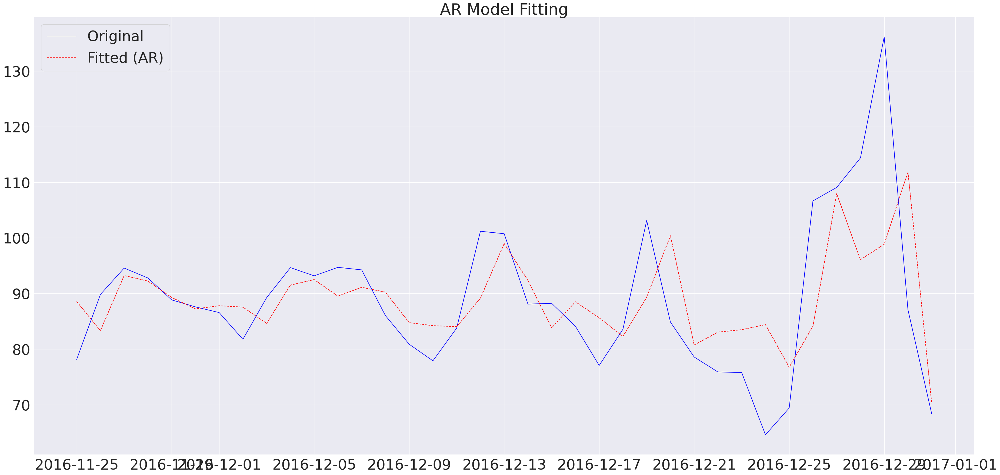

In [ ]:
p = 7  
model_AR2 = ARIMA(df_date_index['Visits'], order=(2, 0, 0)) #AR(2)
results_AR_2 = model_AR2.fit()


plt.figure(figsize=(40, 20))
plt.plot(df_date_index['Visits'], color='blue', label='Original')
plt.plot(results_AR_2.fittedvalues, color='red', label='Fitted (AR)', linestyle='--')
plt.title('AR Model Fitting')
plt.legend(loc='upper left')
plt.show()

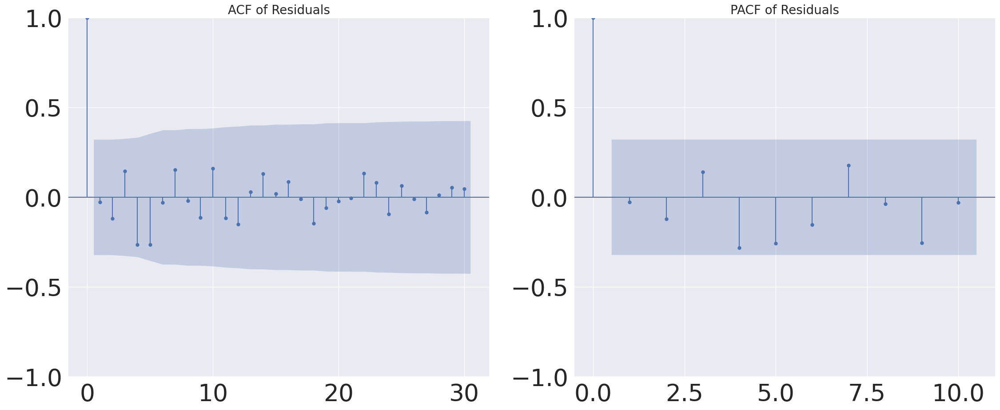

In [ ]:
residuals = results_AR_2.resid


fig, axes = plt.subplots(1, 2, figsize=(24, 10))


plot_acf(residuals, lags=30, ax=axes[0])
axes[0].set_title('ACF of Residuals', fontsize=20)


plot_pacf(residuals, lags=10, ax=axes[1])
axes[1].set_title('PACF of Residuals', fontsize=20)

plt.show()

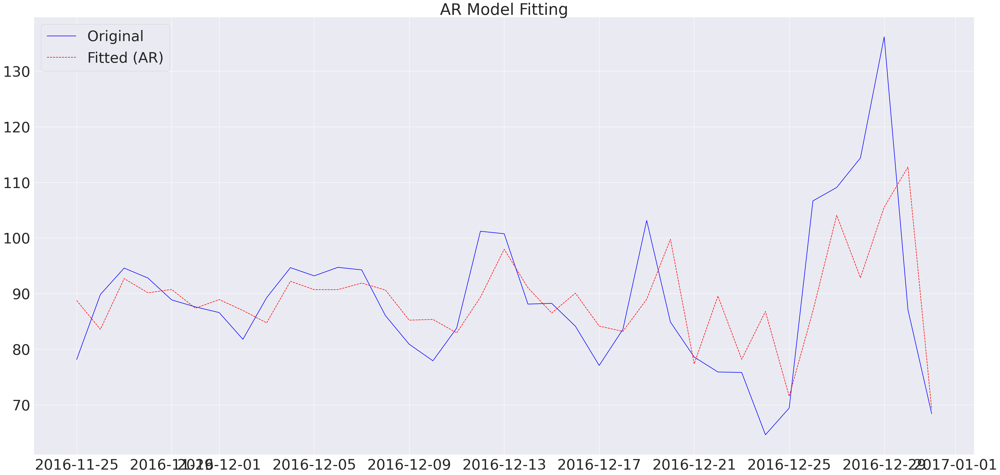

In [ ]:
p = 7  
model_AR3 = ARIMA(df_date_index['Visits'], order=(1, 0, 1))
results_AR3 = model_AR3.fit()


plt.figure(figsize=(40, 20))
plt.plot(df_date_index['Visits'], color='blue', label='Original')
plt.plot(results_AR3.fittedvalues, color='red', label='Fitted (AR)', linestyle='--')
plt.title('AR Model Fitting')
plt.legend(loc='upper left')
plt.show()

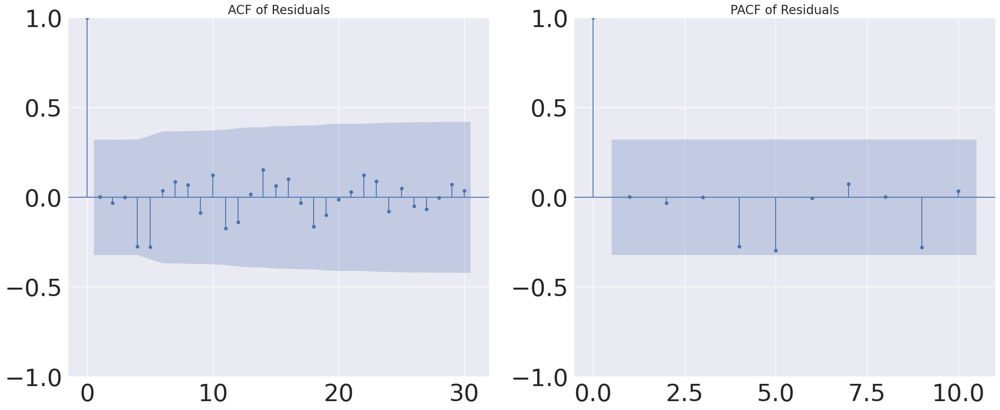

In [ ]:
residuals = results_AR3.resid


fig, axes = plt.subplots(1, 2, figsize=(24, 10))


plot_acf(residuals, lags=30, ax=axes[0])
axes[0].set_title('ACF of Residuals', fontsize=20)


plot_pacf(residuals, lags=10, ax=axes[1])
axes[1].set_title('PACF of Residuals', fontsize=20)

plt.show()

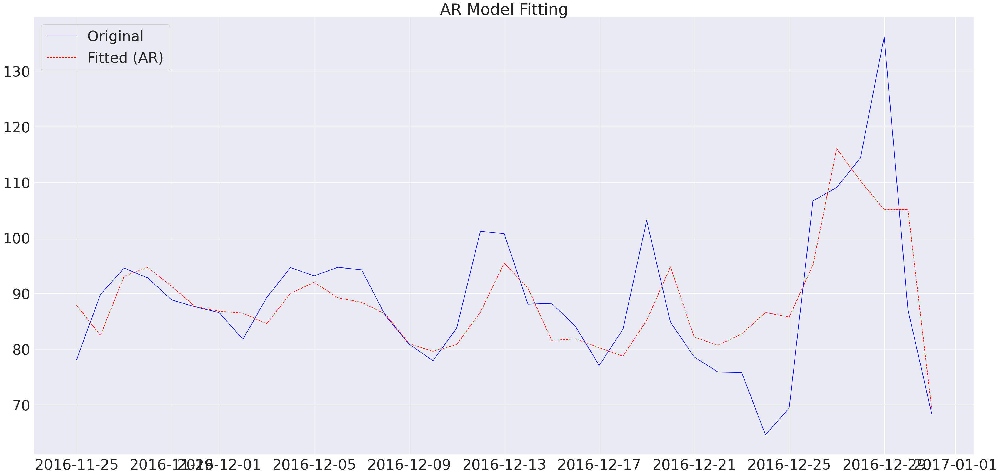

In [ ]:
p = 7  
model_AR5 = ARIMA(df_date_index['Visits'], order=(2, 0, 1))
results_AR5 = model_AR5.fit()


plt.figure(figsize=(40, 20))
plt.plot(df_date_index['Visits'], color='blue', label='Original')
plt.plot(results_AR5.fittedvalues, color='red', label='Fitted (AR)', linestyle='--')
plt.title('AR Model Fitting')
plt.legend(loc='upper left')
plt.show()

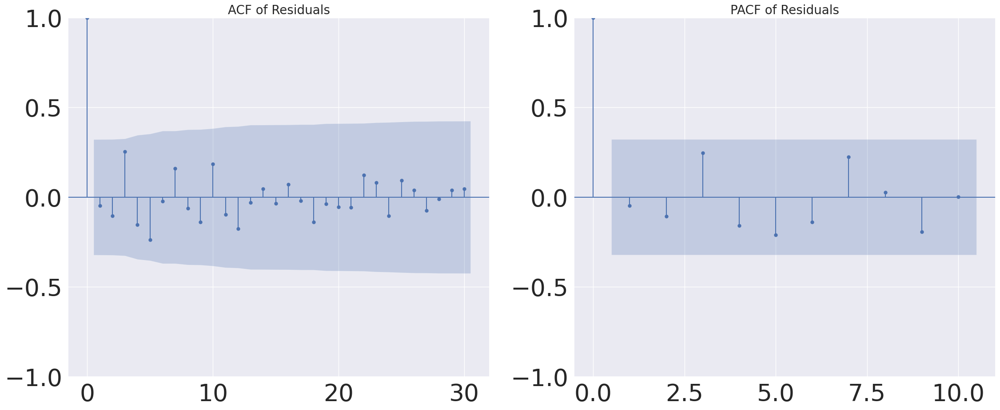

In [ ]:
residuals = results_AR5.resid


fig, axes = plt.subplots(1, 2, figsize=(24, 10))


plot_acf(residuals, lags=30, ax=axes[0])
axes[0].set_title('ACF of Residuals', fontsize=20)


plot_pacf(residuals, lags=10, ax=axes[1])
axes[1].set_title('PACF of Residuals', fontsize=20)

plt.show()

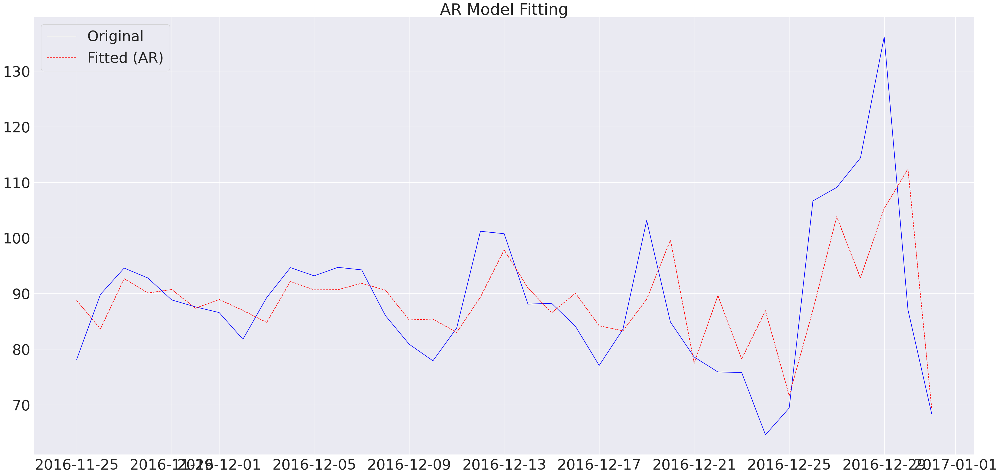

In [ ]:
p = 7  
model_AR6 = ARIMA(df_date_index['Visits'], order=(0, 0, 1))
results_AR6 = model_AR6.fit()


plt.figure(figsize=(40, 20))
plt.plot(df_date_index['Visits'], color='blue', label='Original')
plt.plot(results_AR6.fittedvalues, color='red', label='Fitted (AR)', linestyle='--')
plt.title('AR Model Fitting')
plt.legend(loc='upper left')
plt.show()

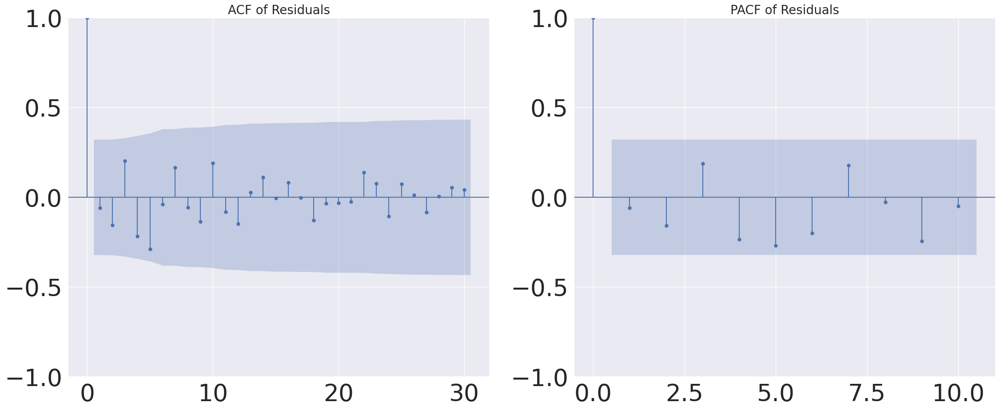

In [ ]:
residuals = results_AR6.resid


fig, axes = plt.subplots(1, 2, figsize=(24, 10))


plot_acf(residuals, lags=30, ax=axes[0])
axes[0].set_title('ACF of Residuals', fontsize=20)


plot_pacf(residuals, lags=10, ax=axes[1])
axes[1].set_title('PACF of Residuals', fontsize=20)

plt.show()

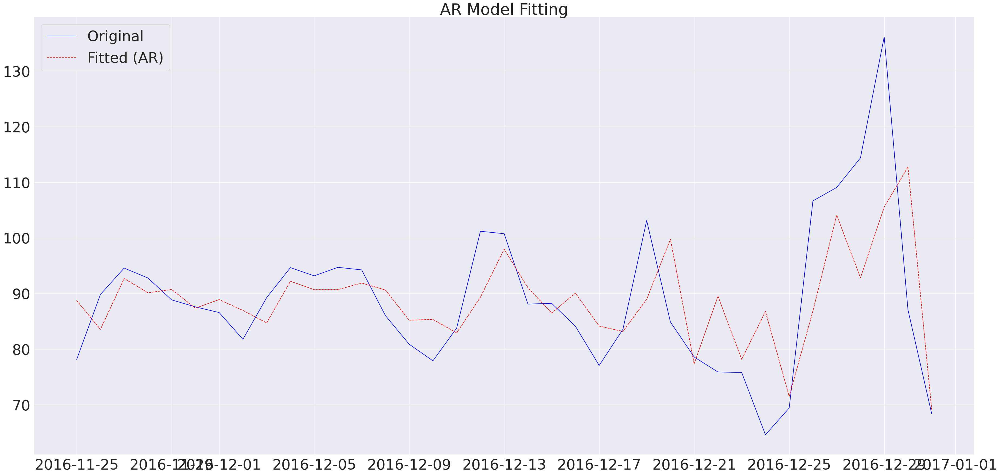

In [ ]:
p = 7  
model_AR7 = ARIMA(df_date_index['Visits'], order=(0, 0, 2))
results_AR7 = model_AR7.fit()


plt.figure(figsize=(40, 20))
plt.plot(df_date_index['Visits'], color='blue', label='Original')
plt.plot(results_AR7.fittedvalues, color='red', label='Fitted (AR)', linestyle='--')
plt.title('AR Model Fitting')
plt.legend(loc='upper left')
plt.show()

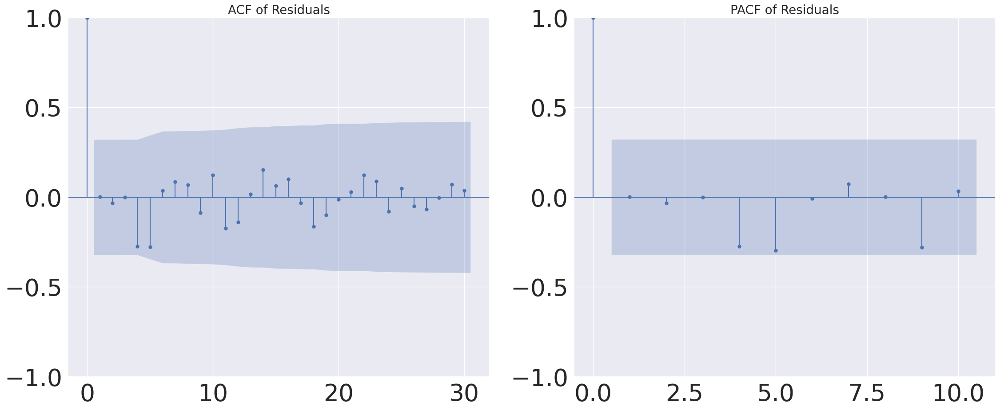

In [ ]:
residuals = results_AR7.resid


fig, axes = plt.subplots(1, 2, figsize=(24, 10))


plot_acf(residuals, lags=30, ax=axes[0])
axes[0].set_title('ACF of Residuals', fontsize=20)


plot_pacf(residuals, lags=10, ax=axes[1])
axes[1].set_title('PACF of Residuals', fontsize=20)

plt.show()

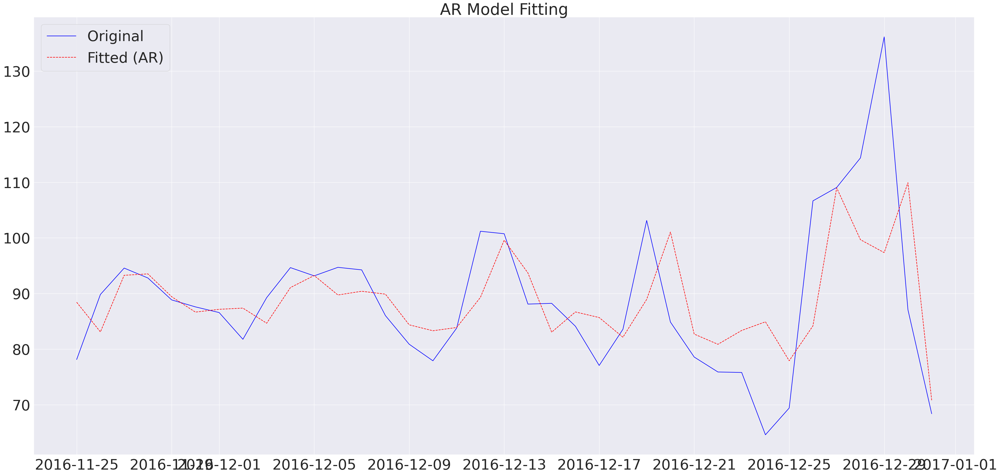

In [ ]:
p = 7  
model_AR6 = ARIMA(df_date_index['Visits'], order=(3, 0, 0))
results_AR6 = model_AR6.fit()


plt.figure(figsize=(40, 20))
plt.plot(df_date_index['Visits'], color='blue', label='Original')
plt.plot(results_AR6.fittedvalues, color='red', label='Fitted (AR)', linestyle='--')
plt.title('AR Model Fitting')
plt.legend(loc='upper left')
plt.show()

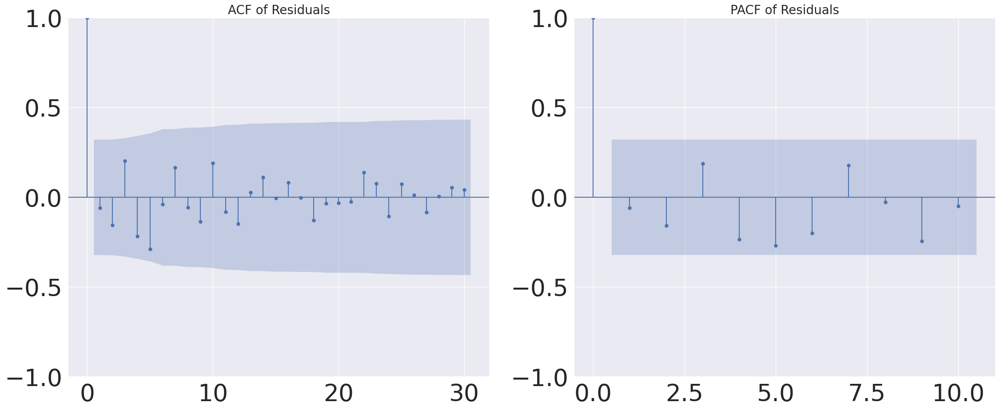

In [ ]:
residuals = results_AR6.resid


fig, axes = plt.subplots(1, 2, figsize=(24, 10))


plot_acf(residuals, lags=30, ax=axes[0])
axes[0].set_title('ACF of Residuals', fontsize=20)


plot_pacf(residuals, lags=10, ax=axes[1])
axes[1].set_title('PACF of Residuals', fontsize=20)

plt.show()

In [ ]:
residuals = results_SARIMA2.resid


fig, axes = plt.subplots(1, 2, figsize=(24, 10))


plot_acf(residuals, lags=30, ax=axes[0])
axes[0].set_title('ACF of Residuals', fontsize=20)


plot_pacf(residuals, lags=10, ax=axes[1])
axes[1].set_title('PACF of Residuals', fontsize=20)

plt.show()

In [ ]:
aic1 = results_AR2.aic
bic1 = results_AR2.bic
print(f" AR(1) Model -> AIC: {aic1}, BIC: {bic1}")

 AR(1) Model -> AIC: 293.509380199701, BIC: 298.34213393763366


In [ ]:
aic1 = results_AR_2.aic
bic1 = results_AR_2.bic
print(f" AR(2) Model -> AIC: {aic1}, BIC: {bic1}")

 AR(2) Model -> AIC: 290.5197442107419, BIC: 296.9634158613188


In [ ]:
aic1 = results_AR3.aic
bic1 = results_AR3.bic
print(f" ARIMA(1,0,1) Model -> AIC: {aic1}, BIC: {bic1}")

 ARIMA(1,0,1) Model -> AIC: 288.41556299540514, BIC: 294.85923464598204


In [ ]:
aic1 = results_AR5.aic
bic1 = results_AR5.bic
print(f" ARIMA(2,0,1) Model -> AIC: {aic1}, BIC: {bic1}")

 ARIMA(2,0,1) Model -> AIC: 283.9304051238878, BIC: 291.9849946871089


In [ ]:
aic1 = results_AR6.aic
bic1 = results_AR6.bic
print(f" AR(3) Model -> AIC: {aic1}, BIC: {bic1}")

 AR(3) Model -> AIC: 292.1174036752645, BIC: 300.1719932384856


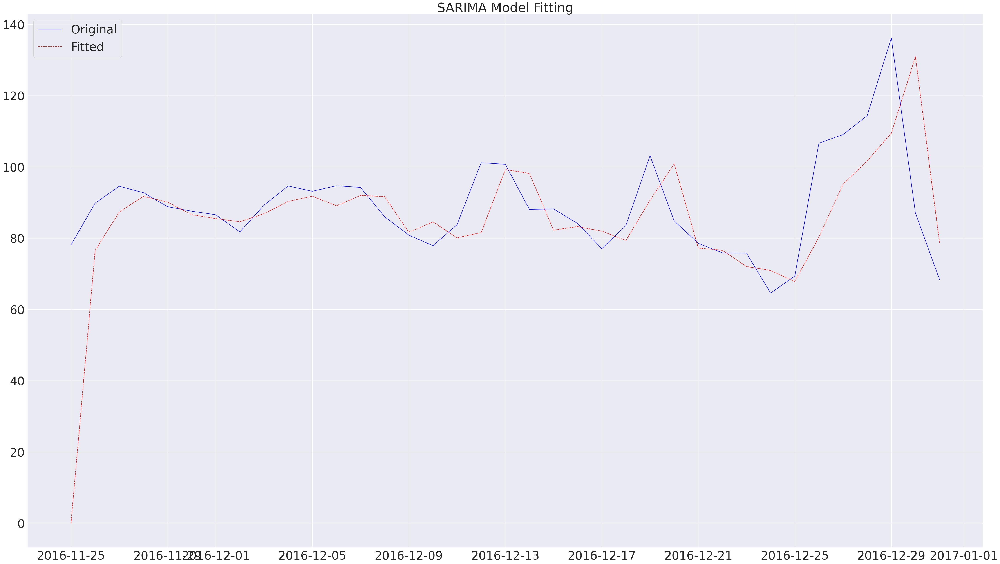

In [ ]:


order = (1, 0, 0)  
seasonal_order = (1, 0, 1, 7)  


model_SAR1 = SARIMAX(df_date_index['Visits'], order=order, seasonal_order=seasonal_order)
results_SARIMA1 = model_SAR1.fit()


plt.figure(figsize=(50, 30))
plt.plot(df_date_index['Visits'], color='blue', label='Original')
plt.plot(results_SARIMA1.fittedvalues, color='red', label='Fitted', linestyle='--')
plt.title('SARIMA Model Fitting')
plt.legend(loc='upper left')
plt.show()


In [ ]:
aic1 = results_SARIMA1.aic
bic1 = results_SARIMA1.bic
print(f" SARIMA (1,0,1) x (1,0,1,7) Model -> AIC: {aic1}, BIC: {bic1}")

 SARIMA (1,0,1) x (1,0,1,7) Model -> AIC: 303.097511305651, BIC: 309.5411829562279


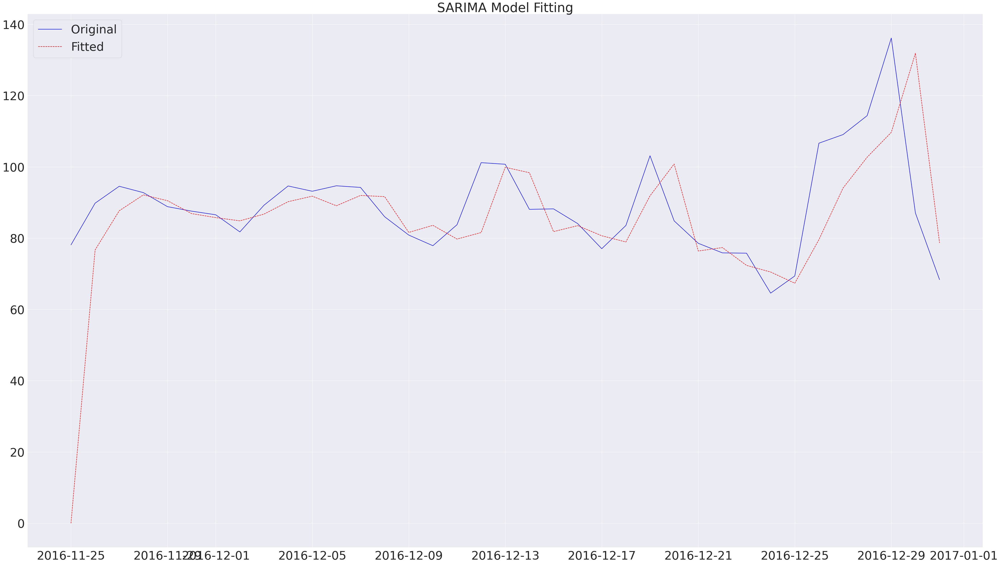

In [ ]:


order = (1, 0, 0)  
seasonal_order = (1, 0, 0, 7)  


model_SAR2 = SARIMAX(df_date_index['Visits'], order=order, seasonal_order=seasonal_order)
results_SARIMA2 = model_SAR2.fit()


plt.figure(figsize=(50, 30))
plt.plot(df_date_index['Visits'], color='blue', label='Original')
plt.plot(results_SARIMA2.fittedvalues, color='red', label='Fitted', linestyle='--')
plt.title('SARIMA Model Fitting')
plt.legend(loc='upper left')
plt.show()


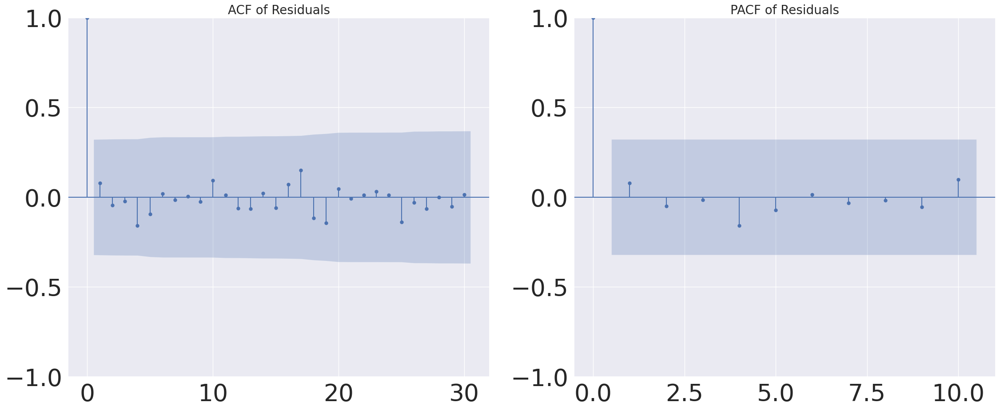

In [ ]:
residuals = results_SARIMA2.resid


fig, axes = plt.subplots(1, 2, figsize=(24, 10))


plot_acf(residuals, lags=30, ax=axes[0])
axes[0].set_title('ACF of Residuals', fontsize=20)


plot_pacf(residuals, lags=10, ax=axes[1])
axes[1].set_title('PACF of Residuals', fontsize=20)

plt.show()

In [ ]:
aic1 = results_SARIMA2.aic
bic1 = results_SARIMA2.bic
print(f" SARIMA (1,0,0) x (1,0,0,7) Model -> AIC: {aic1}, BIC: {bic1}")

 SARIMA (1,0,0) x (1,0,0,7) Model -> AIC: 301.45499990563906, BIC: 306.2877536435717


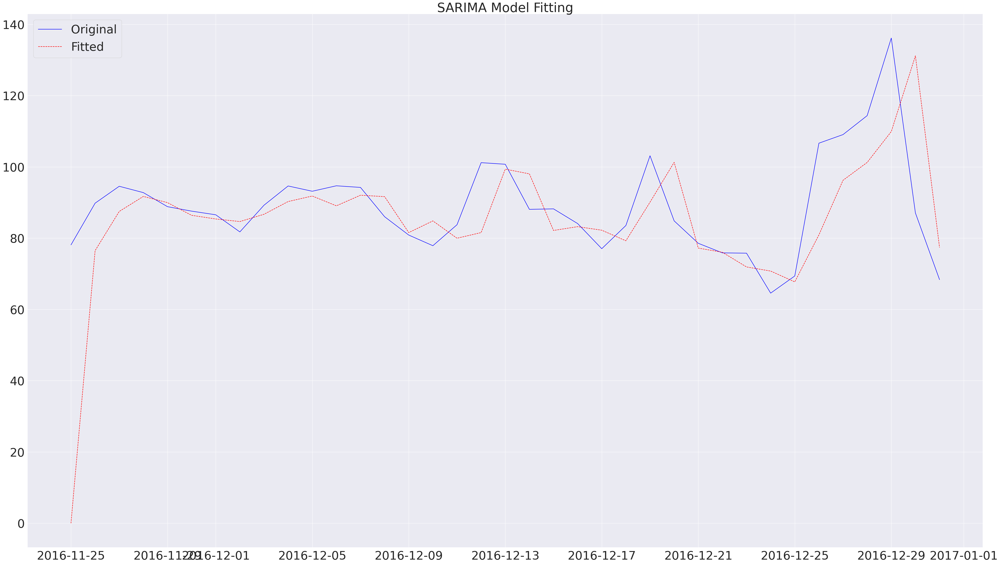

In [ ]:


order = (2, 0, 0)  
seasonal_order = (2, 0, 0, 7)  


model_SAR3 = SARIMAX(df_date_index['Visits'], order=order, seasonal_order=seasonal_order)
results_SARIMA3 = model_SAR3.fit()


plt.figure(figsize=(50, 30))
plt.plot(df_date_index['Visits'], color='blue', label='Original')
plt.plot(results_SARIMA3.fittedvalues, color='red', label='Fitted', linestyle='--')
plt.title('SARIMA Model Fitting')
plt.legend(loc='upper left')
plt.show()


In [ ]:
aic1 = results_SARIMA3.aic
bic1 = results_SARIMA3.bic
print(f" SARIMA (2,0,0) x (2,0,0,7) Model -> AIC: {aic1}, BIC: {bic1}")

 SARIMA (2,0,0) x (2,0,0,7) Model -> AIC: 304.9457969255439, BIC: 313.000386488765


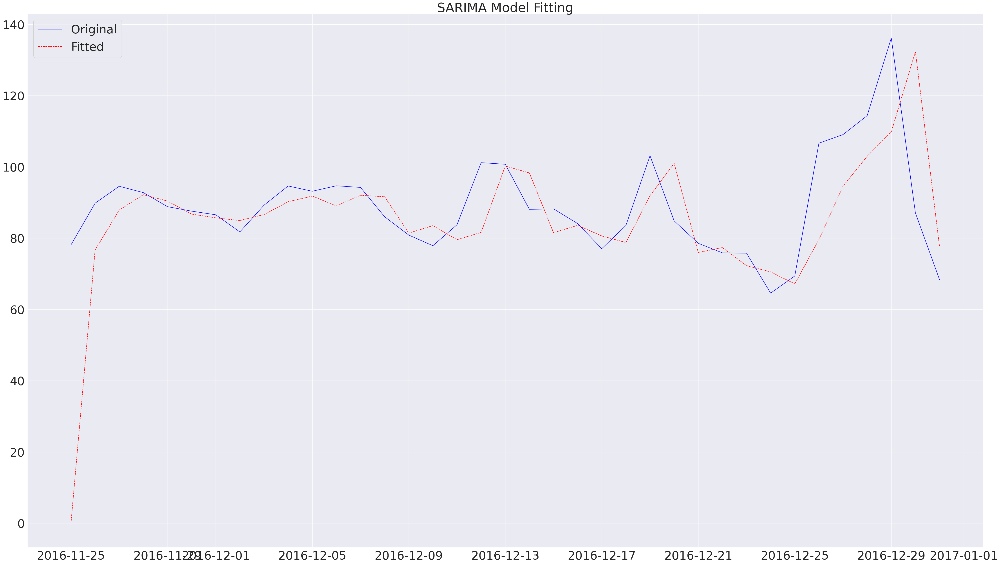

In [ ]:


order = (2, 0, 0)  
seasonal_order = (1, 0, 0, 7)  


model_SAR4 = SARIMAX(df_date_index['Visits'], order=order, seasonal_order=seasonal_order)
results_SARIMA4 = model_SAR4.fit()


plt.figure(figsize=(50, 30))
plt.plot(df_date_index['Visits'], color='blue', label='Original')
plt.plot(results_SARIMA4.fittedvalues, color='red', label='Fitted', linestyle='--')
plt.title('SARIMA Model Fitting')
plt.legend(loc='upper left')
plt.show()


In [ ]:
aic1 = results_SARIMA4.aic
bic1 = results_SARIMA4.bic
print(f" SARIMA (2,0,0) x (1,0,0,7) Model -> AIC: {aic1}, BIC: {bic1}")

 SARIMA (2,0,0) x (1,0,0,7) Model -> AIC: 303.4380064485909, BIC: 309.8816780991678


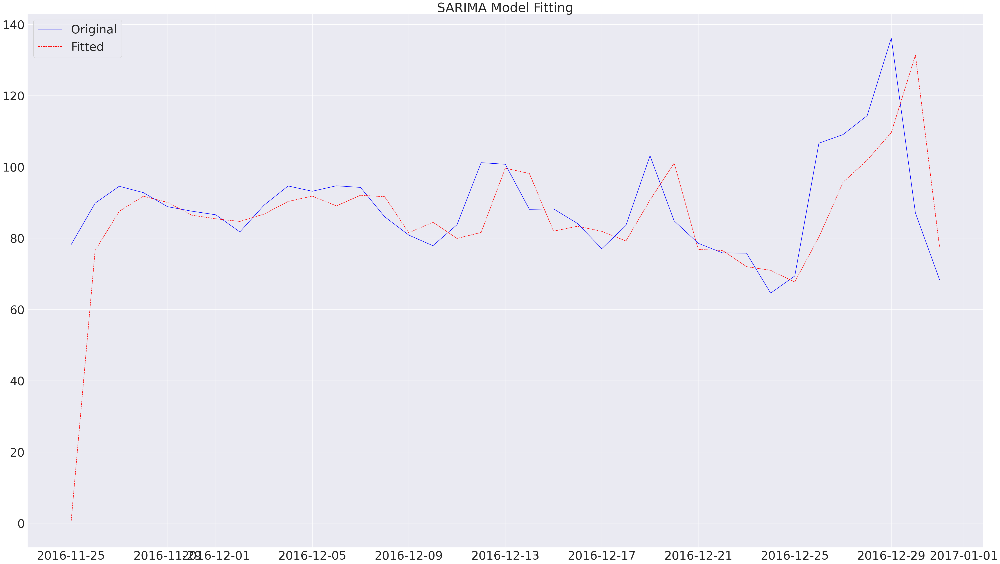

In [ ]:


order = (2, 0, 0)  
seasonal_order = (1, 0, 1, 7)  


model_SAR5 = SARIMAX(df_date_index['Visits'], order=order, seasonal_order=seasonal_order)
results_SARIMA5 = model_SAR5.fit()


plt.figure(figsize=(50, 30))
plt.plot(df_date_index['Visits'], color='blue', label='Original')
plt.plot(results_SARIMA5.fittedvalues, color='red', label='Fitted', linestyle='--')
plt.title('SARIMA Model Fitting')
plt.legend(loc='upper left')
plt.show()


In [ ]:
aic1 = results_SARIMA5.aic
bic1 = results_SARIMA5.bic
print(f" SARIMA (2,0,0) x (1,0,1,7) Model -> AIC: {aic1}, BIC: {bic1}")

 SARIMA (2,0,0) x (1,0,1,7) Model -> AIC: 305.0810370125178, BIC: 313.1356265757389


In [ ]:
#Best Model : SARIMA (1,0,0) x (1,0,0,7) Model

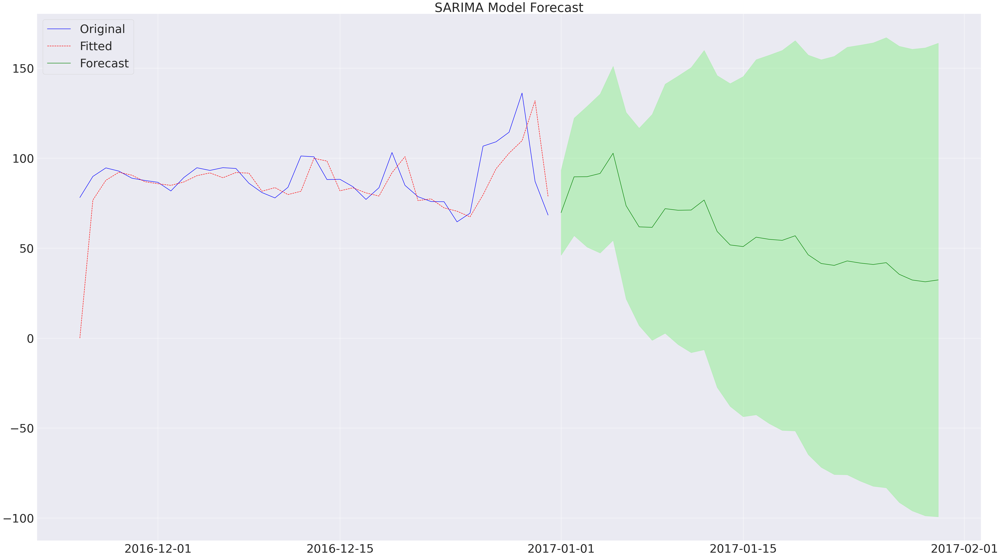

In [ ]:
n_steps_ahead = 30  
forecast = results_SARIMA2.get_forecast(steps=n_steps_ahead)
forecast_index = pd.date_range(start=df_date_index.index[-1] + pd.Timedelta(days=1), periods=n_steps_ahead, freq='D')
forecast_values = forecast.predicted_mean
confidence_intervals = forecast.conf_int()


plt.figure(figsize=(50, 30))
plt.plot(df_date_index['Visits'], color='blue', label='Original')
plt.plot(results_SARIMA2.fittedvalues, color='red', label='Fitted', linestyle='--')
plt.plot(forecast_index, forecast_values, color='green', label='Forecast', linestyle='-')
plt.fill_between(forecast_index, confidence_intervals.iloc[:, 0], confidence_intervals.iloc[:, 1], color='lightgreen', alpha=0.5)
plt.title('SARIMA Model Forecast')
plt.legend(loc='upper left')
plt.show()

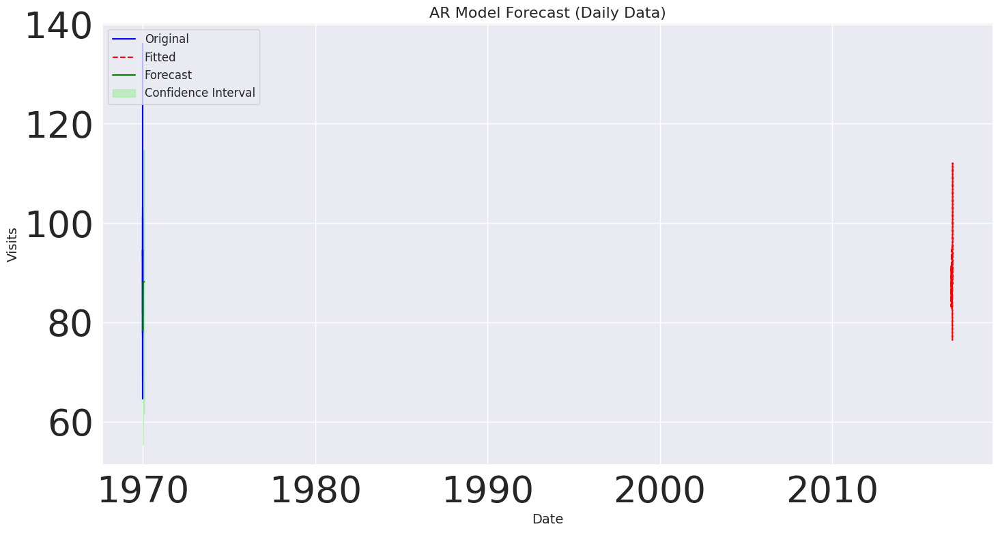

In [ ]:
import pandas as pd
import matplotlib.pyplot as plt


n_steps_ahead = 30  


if not isinstance(df_date_index.index, pd.DatetimeIndex):
    df_date_index.index = pd.to_datetime(df_date_index.index)


forecast = results_AR2.get_forecast(steps=n_steps_ahead)


last_date = df_date_index.index[-1] 
forecast_index = pd.date_range(start=last_date + pd.Timedelta(days=1), periods=n_steps_ahead, freq='D')


forecast_values = forecast.predicted_mean
confidence_intervals = forecast.conf_int()


plt.figure(figsize=(15, 8))


plt.plot(df_date_index['Visits'], color='blue', label='Original')


plt.plot(results_AR2.fittedvalues, color='red', linestyle='--', label='Fitted')


plt.plot(forecast_index, forecast_values, color='green', linestyle='-', label='Forecast')


plt.fill_between(
    forecast_index,
    confidence_intervals.iloc[:, 0],  
    confidence_intervals.iloc[:, 1],  
    color='lightgreen',
    alpha=0.5,
    label='Confidence Interval'
)


plt.title('AR Model Forecast (Daily Data)', fontsize=16)
plt.xlabel('Date', fontsize=14)
plt.ylabel('Visits', fontsize=14)
plt.legend(loc='upper left', fontsize=12)
plt.grid(True)


plt.show()


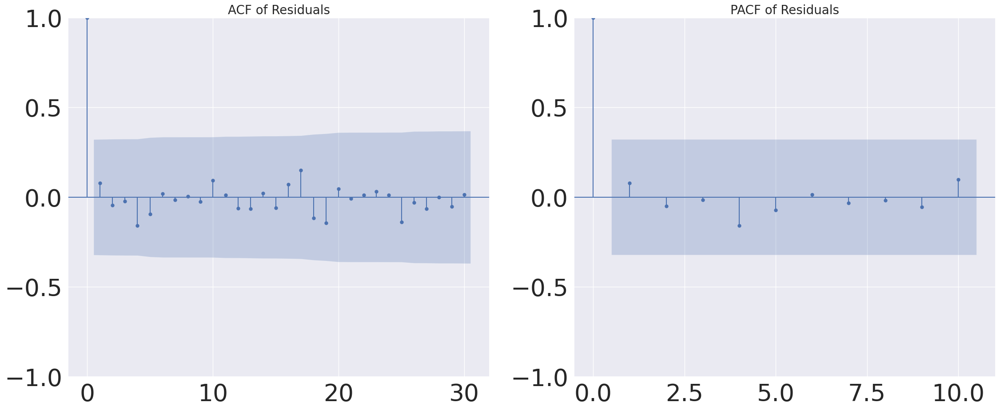

In [ ]:
residuals = results_SARIMA2.resid


fig, axes = plt.subplots(1, 2, figsize=(24, 10))


plot_acf(residuals, lags=30, ax=axes[0])
axes[0].set_title('ACF of Residuals', fontsize=20)


plot_pacf(residuals, lags=10, ax=axes[1])
axes[1].set_title('PACF of Residuals', fontsize=20)

plt.show()

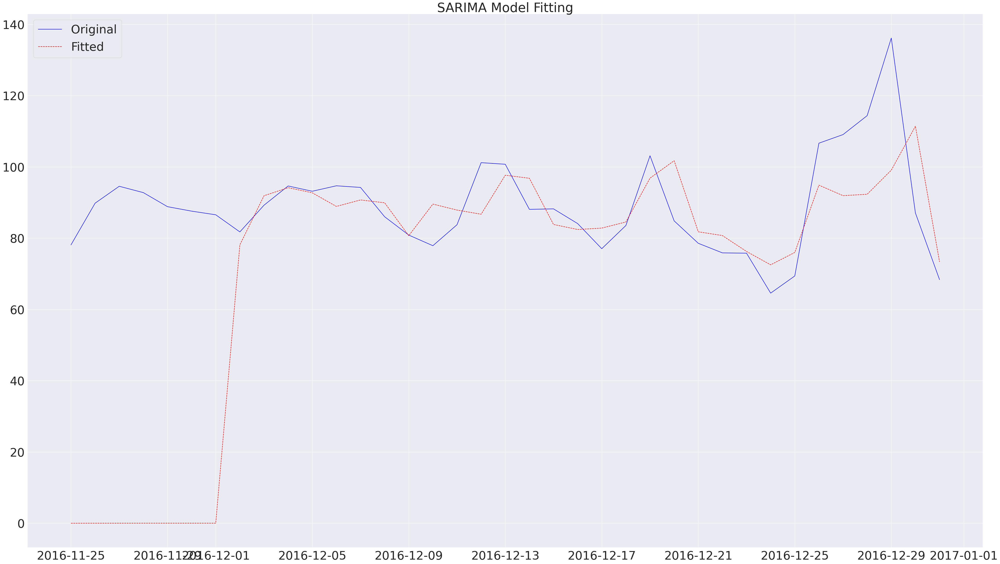

In [ ]:


order = (1, 0, 0) 
seasonal_order = (1, 1, 1, 7)  


model_SAR6 = SARIMAX(df_date_index['Visits'], order=order, seasonal_order=seasonal_order)
results_SARIMA6 = model_SAR6.fit()


plt.figure(figsize=(50, 30))
plt.plot(df_date_index['Visits'], color='blue', label='Original')
plt.plot(results_SARIMA6.fittedvalues, color='red', label='Fitted', linestyle='--')
plt.title('SARIMA Model Fitting')
plt.legend(loc='upper left')
plt.show()


In [ ]:
aic1 = results_SARIMA6.aic
bic1 = results_SARIMA6.bic
print(f" SARIMA (1,0,0) x (1,1,1,7) Model -> AIC: {aic1}, BIC: {bic1}")

 SARIMA (1,0,0) x (1,1,1,7) Model -> AIC: 240.6854605370083, BIC: 246.29025006365694


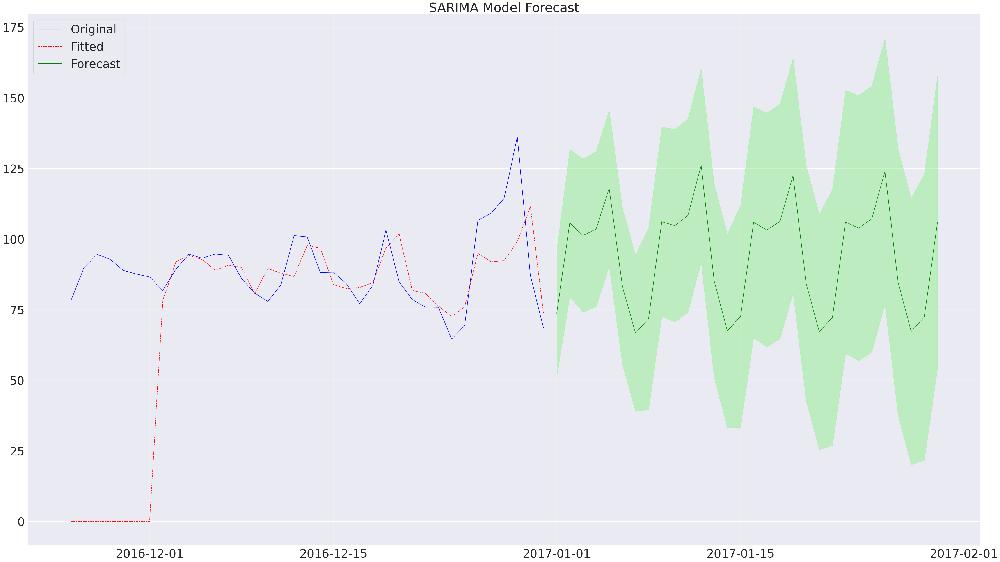

In [ ]:
n_steps_ahead = 30  
forecast = results_SARIMA6.get_forecast(steps=n_steps_ahead)
forecast_index = pd.date_range(start=df_date_index.index[-1] + pd.Timedelta(days=1), periods=n_steps_ahead, freq='D')
forecast_values = forecast.predicted_mean
confidence_intervals = forecast.conf_int()


plt.figure(figsize=(50, 30))
plt.plot(df_date_index['Visits'], color='blue', label='Original')
plt.plot(results_SARIMA6.fittedvalues, color='red', label='Fitted', linestyle='--')
plt.plot(forecast_index, forecast_values, color='green', label='Forecast', linestyle='-')
plt.fill_between(forecast_index, confidence_intervals.iloc[:, 0], confidence_intervals.iloc[:, 1], color='lightgreen', alpha=0.5)
plt.title('SARIMA Model Forecast')
plt.legend(loc='upper left')
plt.show()

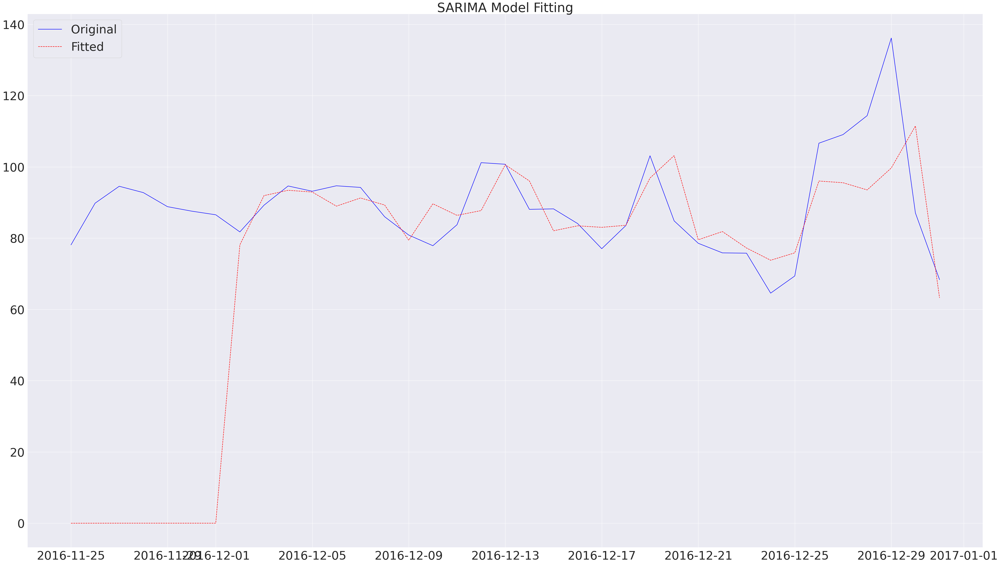

In [ ]:


order = (2, 0, 0)  
seasonal_order = (1, 1, 1, 7) 


model_SAR7 = SARIMAX(df_date_index['Visits'], order=order, seasonal_order=seasonal_order)
results_SARIMA7 = model_SAR7.fit()


plt.figure(figsize=(50, 30))
plt.plot(df_date_index['Visits'], color='blue', label='Original')
plt.plot(results_SARIMA7.fittedvalues, color='red', label='Fitted', linestyle='--')
plt.title('SARIMA Model Fitting')
plt.legend(loc='upper left')
plt.show()


In [ ]:
aic1 = results_SARIMA7.aic
bic1 = results_SARIMA7.bic
print(f" SARIMA (2,0,0) x (1,1,1,7) Model -> AIC: {aic1}, BIC: {bic1}")

 SARIMA (2,0,0) x (1,1,1,7) Model -> AIC: 241.47190870928563, BIC: 248.4778956175964


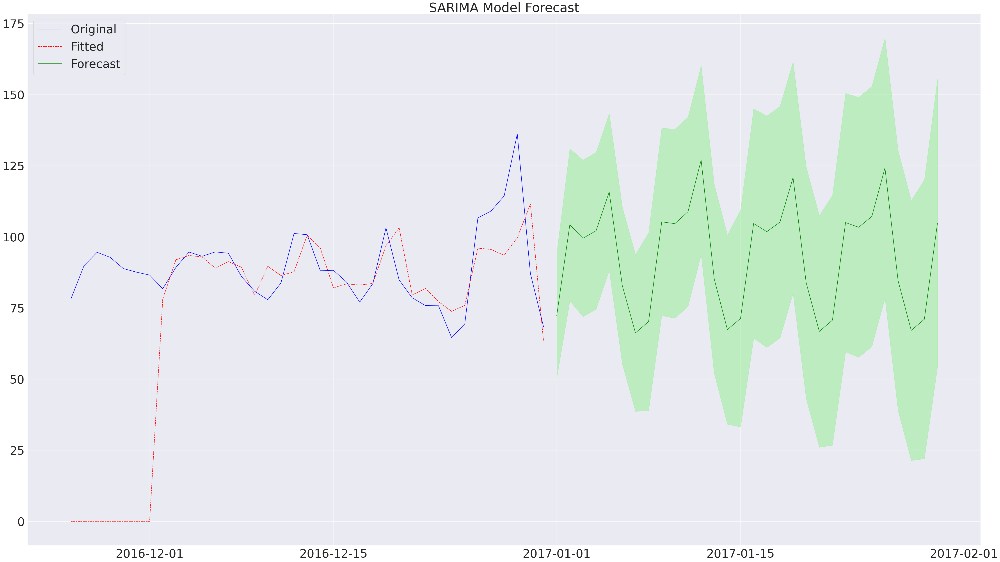

In [ ]:
n_steps_ahead = 30  
forecast = results_SARIMA7.get_forecast(steps=n_steps_ahead)
forecast_index = pd.date_range(start=df_date_index.index[-1] + pd.Timedelta(days=1), periods=n_steps_ahead, freq='D')
forecast_values = forecast.predicted_mean
confidence_intervals = forecast.conf_int()


plt.figure(figsize=(50, 30))
plt.plot(df_date_index['Visits'], color='blue', label='Original')
plt.plot(results_SARIMA7.fittedvalues, color='red', label='Fitted', linestyle='--')
plt.plot(forecast_index, forecast_values, color='green', label='Forecast', linestyle='-')
plt.fill_between(forecast_index, confidence_intervals.iloc[:, 0], confidence_intervals.iloc[:, 1], color='lightgreen', alpha=0.5)
plt.title('SARIMA Model Forecast')
plt.legend(loc='upper left')
plt.show()

In [ ]:
predictions = results_SARIMA7.predict()


mse = mean_squared_error(df_date_index['Visits'], predictions)
rmse = np.sqrt(mse)
mae = mean_absolute_error(df_date_index['Visits'], predictions)
r2 = r2_score(df_date_index['Visits'], predictions)

print(f'MSE: {mse}')
print(f'RMSE: {rmse}')
print(f'MAE: {mae}')
print(f'R2 Score: {r2}')

MSE: 1581.74803128735
RMSE: 39.77119600021289
MAE: 22.91423676870329
R2 Score: -7.720845728843727


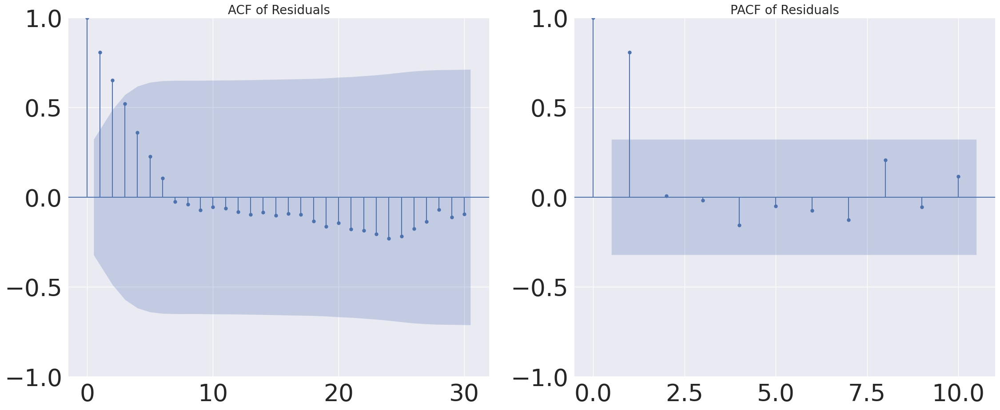

In [ ]:
residuals = results_SARIMA7.resid


fig, axes = plt.subplots(1, 2, figsize=(24, 10))


plot_acf(residuals, lags=30, ax=axes[0])
axes[0].set_title('ACF of Residuals', fontsize=20)


plot_pacf(residuals, lags=10, ax=axes[1])
axes[1].set_title('PACF of Residuals', fontsize=20)

plt.show()

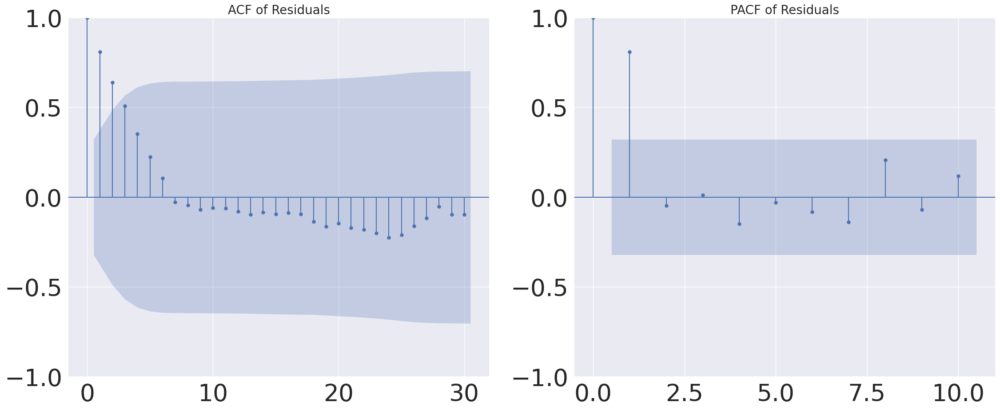

In [ ]:
residuals = results_SARIMA6.resid


fig, axes = plt.subplots(1, 2, figsize=(24, 10))


plot_acf(residuals, lags=30, ax=axes[0])
axes[0].set_title('ACF of Residuals', fontsize=20)


plot_pacf(residuals, lags=10, ax=axes[1])
axes[1].set_title('PACF of Residuals', fontsize=20)

plt.show()

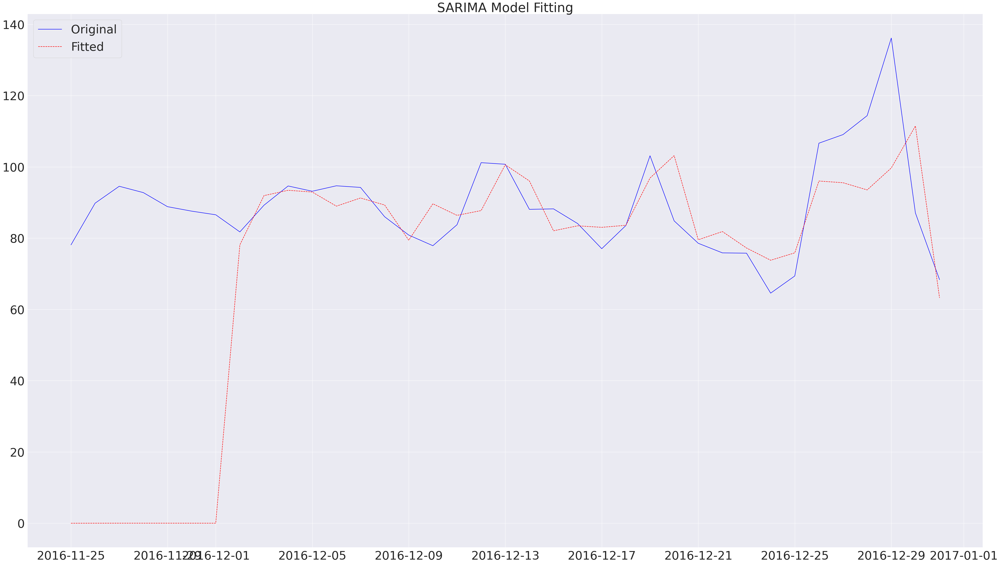

In [ ]:


order = (1, 0, 0)  
seasonal_order = (1, 1, 2, 7)  


model_SAR8 = SARIMAX(df_date_index['Visits'], order=order, seasonal_order=seasonal_order)
results_SARIMA8 = model_SAR7.fit()


plt.figure(figsize=(50, 30))
plt.plot(df_date_index['Visits'], color='blue', label='Original')
plt.plot(results_SARIMA8.fittedvalues, color='red', label='Fitted', linestyle='--')
plt.title('SARIMA Model Fitting')
plt.legend(loc='upper left')
plt.show()


In [ ]:
aic1 = results_SARIMA8.aic
bic1 = results_SARIMA8.bic
print(f" SARIMA (2,0,0) x (1,1,1,7) Model -> AIC: {aic1}, BIC: {bic1}")

 SARIMA (2,0,0) x (1,1,1,7) Model -> AIC: 241.47190870928563, BIC: 248.4778956175964


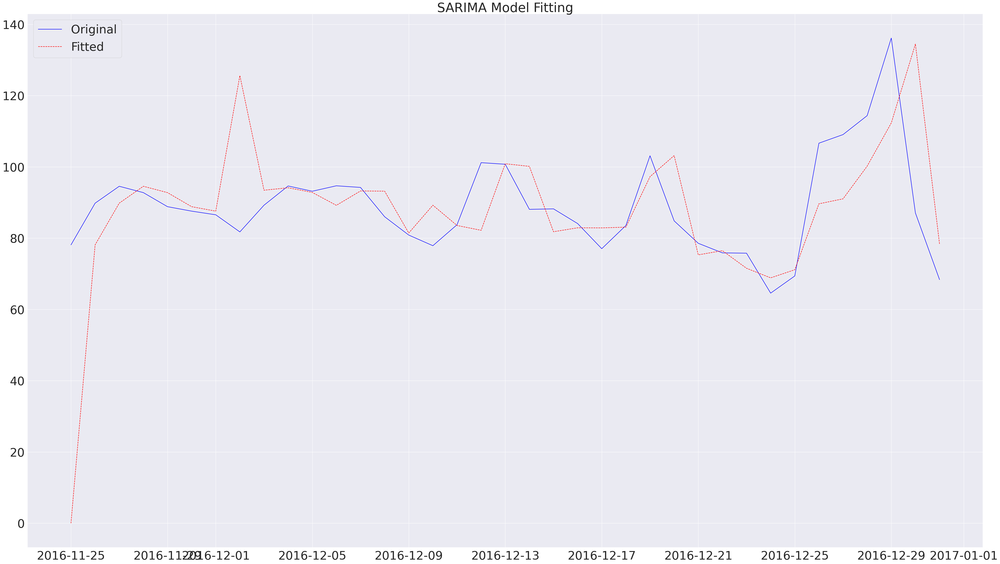

In [ ]:


order = (1, 1, 0)  
seasonal_order = (1, 1, 1, 7)  


model_SAR8 = SARIMAX(df_date_index['Visits'], order=order, seasonal_order=seasonal_order)
results_SARIMA8 = model_SAR8.fit()


plt.figure(figsize=(50, 30))
plt.plot(df_date_index['Visits'], color='blue', label='Original')
plt.plot(results_SARIMA8.fittedvalues, color='red', label='Fitted', linestyle='--')
plt.title('SARIMA Model Fitting')
plt.legend(loc='upper left')
plt.show()


In [ ]:
aic1 = results_SARIMA8.aic
bic1 = results_SARIMA8.bic
print(f" SARIMA (2,0,0) x (1,1,1,7) Model -> AIC: {aic1}, BIC: {bic1}")

 SARIMA (2,0,0) x (1,1,1,7) Model -> AIC: 239.7686535373834, BIC: 245.23783685732928


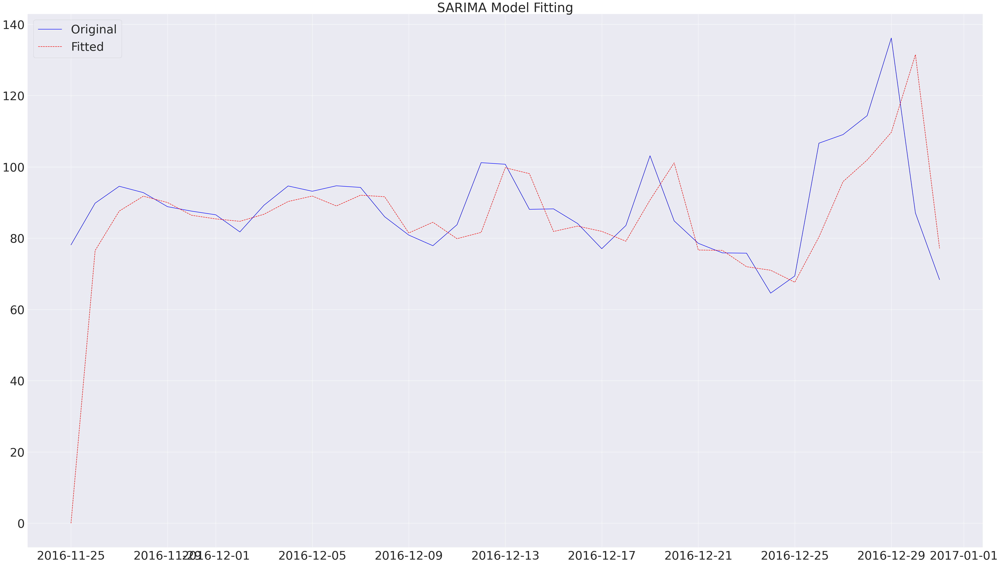

In [ ]:


order = (1, 0, 1)  
seasonal_order = (1, 0, 1, 7)  


model_SAR8 = SARIMAX(df_date_index['Visits'], order=order, seasonal_order=seasonal_order)
results_SARIMA8 = model_SAR8.fit()


plt.figure(figsize=(50, 30))
plt.plot(df_date_index['Visits'], color='blue', label='Original')
plt.plot(results_SARIMA8.fittedvalues, color='red', label='Fitted', linestyle='--')
plt.title('SARIMA Model Fitting')
plt.legend(loc='upper left')
plt.show()


In [ ]:
aic1 = results_SARIMA8.aic
bic1 = results_SARIMA8.bic
print(f" SARIMA (2,0,0) x (1,1,1,7) Model -> AIC: {aic1}, BIC: {bic1}")

 SARIMA (2,0,0) x (1,1,1,7) Model -> AIC: 305.07510815277266, BIC: 313.12969771599376


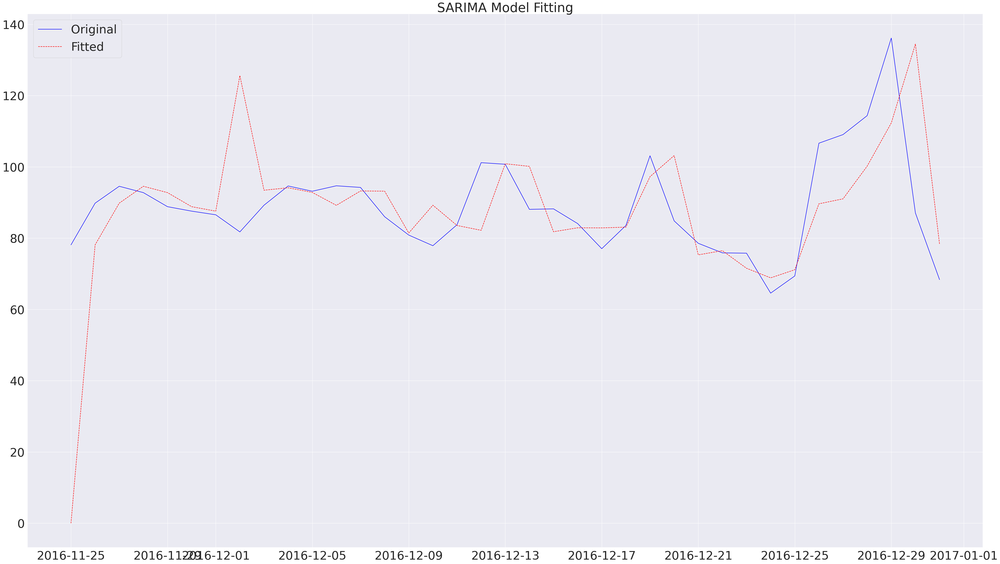

In [ ]:


order = (1, 1, 0)  
seasonal_order = (1, 1, 1, 7)  


model_SAR8 = SARIMAX(df_date_index['Visits'], order=order, seasonal_order=seasonal_order)
results_SARIMA8 = model_SAR8.fit()


plt.figure(figsize=(50, 30))
plt.plot(df_date_index['Visits'], color='blue', label='Original')
plt.plot(results_SARIMA8.fittedvalues, color='red', label='Fitted', linestyle='--')
plt.title('SARIMA Model Fitting')
plt.legend(loc='upper left')
plt.show()


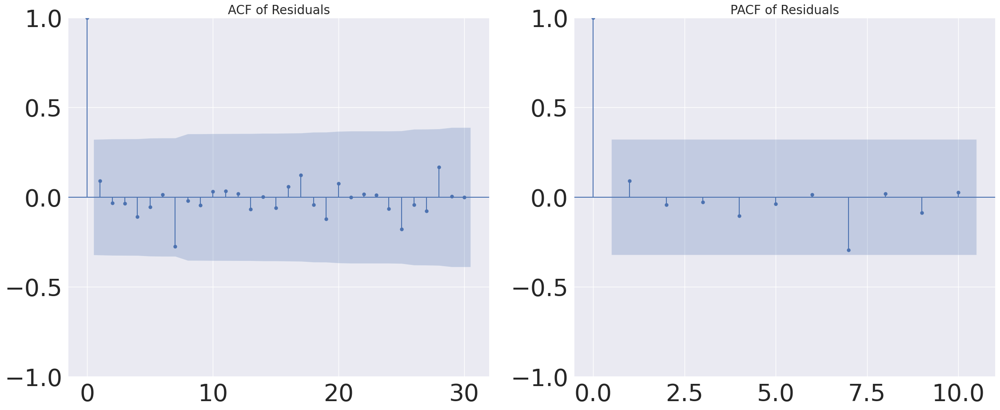

In [ ]:
residuals = results_SARIMA8.resid


fig, axes = plt.subplots(1, 2, figsize=(24, 10))


plot_acf(residuals, lags=30, ax=axes[0])
axes[0].set_title('ACF of Residuals', fontsize=20)


plot_pacf(residuals, lags=10, ax=axes[1])
axes[1].set_title('PACF of Residuals', fontsize=20)

plt.show()

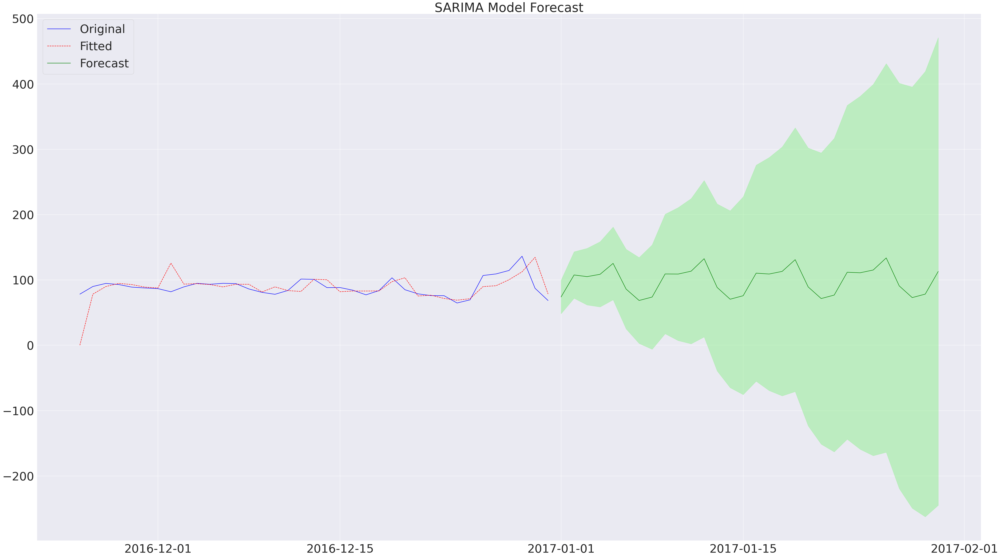

In [ ]:
n_steps_ahead = 30  
forecast = results_SARIMA8.get_forecast(steps=n_steps_ahead)
forecast_index = pd.date_range(start=df_date_index.index[-1] + pd.Timedelta(days=1), periods=n_steps_ahead, freq='D')
forecast_values = forecast.predicted_mean
confidence_intervals = forecast.conf_int()


plt.figure(figsize=(50, 30))
plt.plot(df_date_index['Visits'], color='blue', label='Original')
plt.plot(results_SARIMA8.fittedvalues, color='red', label='Fitted', linestyle='--')
plt.plot(forecast_index, forecast_values, color='green', label='Forecast', linestyle='-')
plt.fill_between(forecast_index, confidence_intervals.iloc[:, 0], confidence_intervals.iloc[:, 1], color='lightgreen', alpha=0.5)
plt.title('SARIMA Model Forecast')
plt.legend(loc='upper left')
plt.show()

In [ ]:
print(df_date_index)

                Visits  Visits_detrended  Visits_diff  Visits_moving_avg  \
date                                                                       
2016-11-25   78.117422         -5.119461    -3.570002          83.236883   
2016-11-26   89.820141          4.612838    13.792940          85.207303   
2016-11-27   94.564955          8.370099     6.912868          86.194856   
2016-11-28   92.781760          6.033164     3.876183          86.748596   
2016-11-29   88.840323          1.680212     2.880605          87.160111   
2016-11-30   87.585700         -0.227785     4.573615          87.813485   
2016-12-01   86.562487         -1.762196     3.578396          88.324684   
2016-12-02   81.753270         -7.090821     3.635848          88.844091   
2016-12-03   89.247385          0.485117    -0.572756          88.762269   
2016-12-04   94.647839          5.873730     0.082885          88.774109   
2016-12-05   93.167102          4.337944     0.385343          88.829158   
2016-12-06  

DEBUG:cmdstanpy:input tempfile: /tmp/tmp431jg8tx/mdp9gfrx.json
DEBUG:cmdstanpy:input tempfile: /tmp/tmp431jg8tx/g3zng31t.json
DEBUG:cmdstanpy:idx 0
DEBUG:cmdstanpy:running CmdStan, num_threads: None
DEBUG:cmdstanpy:CmdStan args: ['/usr/local/lib/python3.10/dist-packages/prophet/stan_model/prophet_model.bin', 'random', 'seed=93739', 'data', 'file=/tmp/tmp431jg8tx/mdp9gfrx.json', 'init=/tmp/tmp431jg8tx/g3zng31t.json', 'output', 'file=/tmp/tmp431jg8tx/prophet_modeln1lbwe33/prophet_model-20241125070850.csv', 'method=optimize', 'algorithm=newton', 'iter=10000']
07:08:50 - cmdstanpy - INFO - Chain [1] start processing
INFO:cmdstanpy:Chain [1] start processing
07:08:50 - cmdstanpy - INFO - Chain [1] done processing
INFO:cmdstanpy:Chain [1] done processing


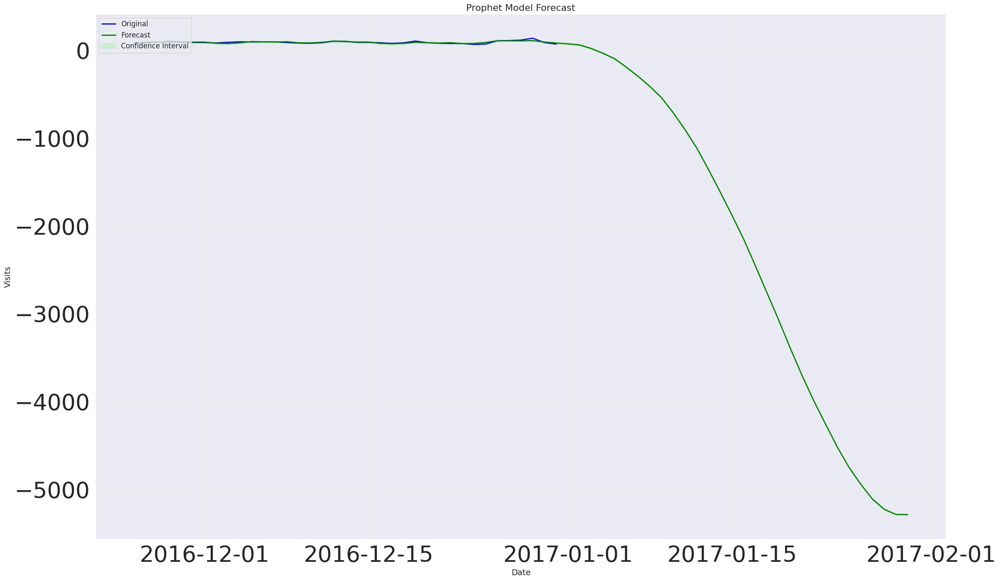

AIC: 173.25469735243036
BIC: 184.53112274093994


In [ ]:
from prophet import Prophet
from sklearn.metrics import mean_squared_error
import numpy as np
import pandas as pd
import matplotlib.pyplot as plt


df_prophet = df_date_index.reset_index()
df_prophet.rename(columns={'date': 'ds', 'Visits': 'y'}, inplace=True)


model = Prophet(yearly_seasonality=True, weekly_seasonality=True, daily_seasonality=False)
model.fit(df_prophet)


future = model.make_future_dataframe(periods=n_steps_ahead, freq='D')
forecast = model.predict(future)


plt.figure(figsize=(25, 15))
plt.plot(df_prophet['ds'], df_prophet['y'], color='blue', label='Original', linewidth=2)
plt.plot(forecast['ds'], forecast['yhat'], color='green', label='Forecast', linestyle='-', linewidth=2)


plt.fill_between(
    forecast['ds'],
    forecast['yhat_lower'],
    forecast['yhat_upper'],
    color='lightgreen',
    alpha=0.3,
    label='Confidence Interval'
)


plt.title('Prophet Model Forecast', fontsize=16)
plt.xlabel('Date', fontsize=14)
plt.ylabel('Visits', fontsize=14)
plt.legend(loc='upper left', fontsize=12)
plt.grid(alpha=0.3)
plt.tight_layout()
plt.show()


y_true = df_prophet['y']
y_pred = forecast.loc[:len(y_true)-1, 'yhat']
rss = np.sum((y_true - y_pred)**2)
n = len(y_true)
k = len(model.params)  

aic = n * np.log(rss / n) + 2 * k
bic = n * np.log(rss / n) + k * np.log(n)

print(f"AIC: {aic}")
print(f"BIC: {bic}")




DEBUG:cmdstanpy:input tempfile: /tmp/tmp431jg8tx/7db6epy1.json
DEBUG:cmdstanpy:input tempfile: /tmp/tmp431jg8tx/60i0jpxo.json
DEBUG:cmdstanpy:idx 0
DEBUG:cmdstanpy:running CmdStan, num_threads: None
DEBUG:cmdstanpy:CmdStan args: ['/usr/local/lib/python3.10/dist-packages/prophet/stan_model/prophet_model.bin', 'random', 'seed=8605', 'data', 'file=/tmp/tmp431jg8tx/7db6epy1.json', 'init=/tmp/tmp431jg8tx/60i0jpxo.json', 'output', 'file=/tmp/tmp431jg8tx/prophet_model83v_5kv5/prophet_model-20241125070851.csv', 'method=optimize', 'algorithm=newton', 'iter=10000']
07:08:51 - cmdstanpy - INFO - Chain [1] start processing
INFO:cmdstanpy:Chain [1] start processing
07:08:51 - cmdstanpy - INFO - Chain [1] done processing
INFO:cmdstanpy:Chain [1] done processing


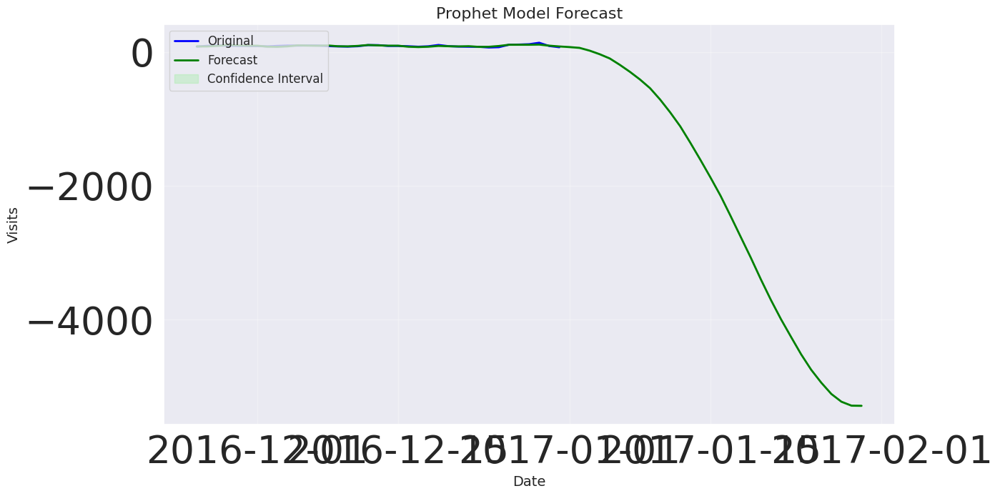

Prophet MAE: 2418.977230577396
Prophet RMSE: 3096.4054426243697


<Figure size 1500x800 with 0 Axes>

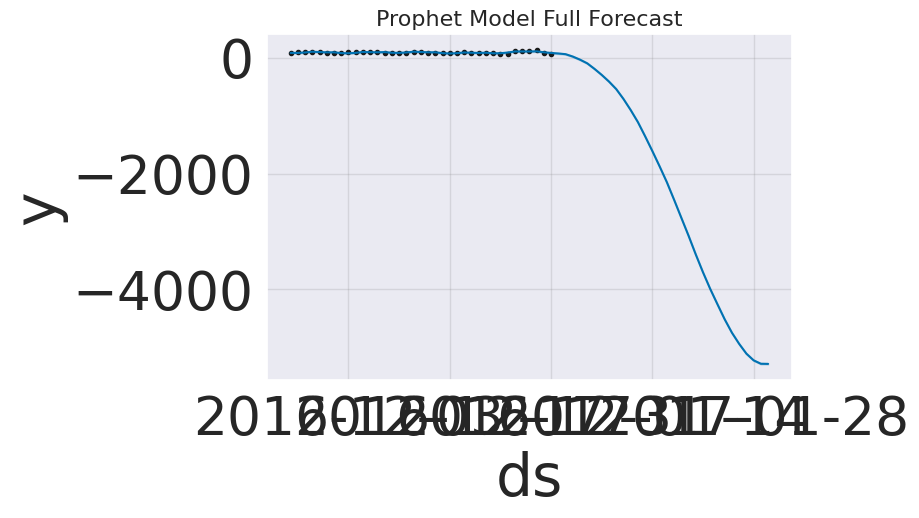

In [ ]:
from prophet import Prophet
from sklearn.metrics import mean_absolute_error, mean_squared_error
import numpy as np
import pandas as pd
import matplotlib.pyplot as plt


df_prophet = df_date_index.reset_index()
df_prophet.rename(columns={'date': 'ds', 'Visits': 'y'}, inplace=True)


model = Prophet(yearly_seasonality=True, weekly_seasonality=True, daily_seasonality=False)
model.fit(df_prophet)


future = model.make_future_dataframe(periods=n_steps_ahead, freq='D')
forecast = model.predict(future)


plt.figure(figsize=(15, 8))
plt.plot(df_prophet['ds'], df_prophet['y'], color='blue', label='Original', linewidth=2)
plt.plot(forecast['ds'], forecast['yhat'], color='green', label='Forecast', linestyle='-', linewidth=2)


plt.fill_between(
    forecast['ds'],
    forecast['yhat_lower'],
    forecast['yhat_upper'],
    color='lightgreen',
    alpha=0.3,
    label='Confidence Interval'
)


plt.title('Prophet Model Forecast', fontsize=16)
plt.xlabel('Date', fontsize=14)
plt.ylabel('Visits', fontsize=14)
plt.legend(loc='upper left', fontsize=12)
plt.grid(alpha=0.3)
plt.tight_layout()
plt.show()


test = df_prophet.iloc[-n_steps_ahead:]  
y_true = test['y']
y_pred = forecast.iloc[-n_steps_ahead:]['yhat']

mae = mean_absolute_error(y_true, y_pred)
rmse = mean_squared_error(y_true, y_pred, squared=False)

print(f"Prophet MAE: {mae}")
print(f"Prophet RMSE: {rmse}")


plt.figure(figsize=(15, 8))
model.plot(forecast)
plt.title('Prophet Model Full Forecast', fontsize=16)
plt.show()


In [ ]:
from sklearn.metrics import mean_squared_error, mean_absolute_error, r2_score


predictions = results_SARIMA8.predict()


mse = mean_squared_error(df_date_index['Visits'], predictions)
rmse = np.sqrt(mse)
mae = mean_absolute_error(df_date_index['Visits'], predictions)
r2 = r2_score(df_date_index['Visits'], predictions)

print(f'MSE: {mse}')
print(f'RMSE: {rmse}')
print(f'MAE: {mae}')
print(f'R2 Score: {r2}')

MSE: 356.03848705218417
RMSE: 18.86898214139237
MAE: 10.572529928077193
R2 Score: -0.9629907277873879


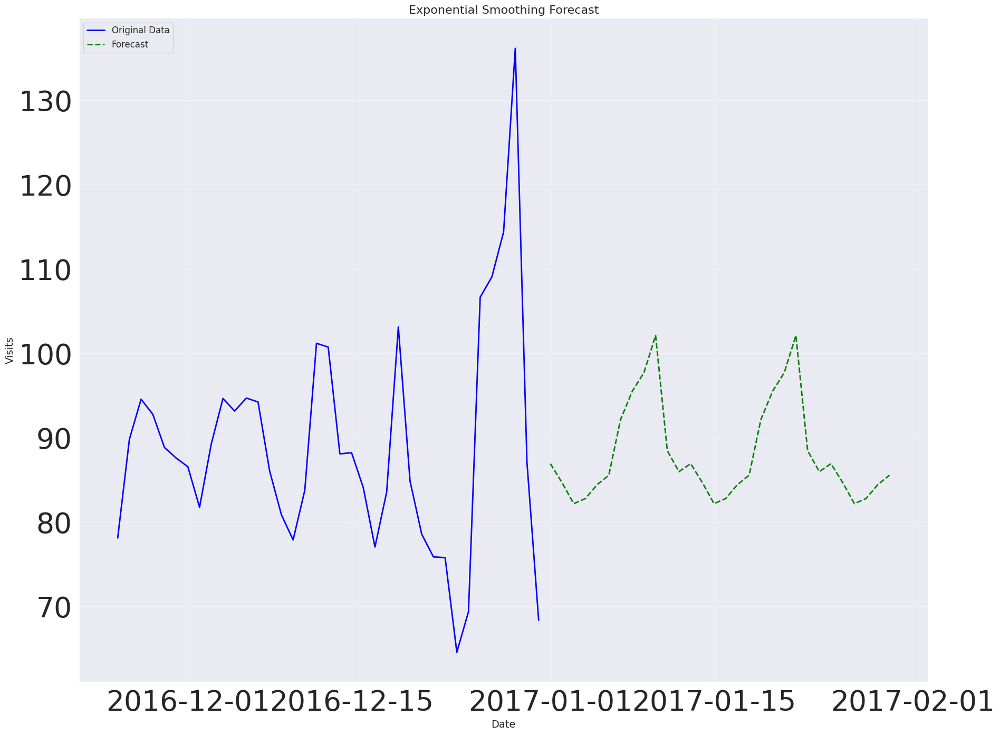

In [ ]:
from statsmodels.tsa.holtwinters import ExponentialSmoothing

model = ExponentialSmoothing(df_date_index['Visits'], seasonal='add', seasonal_periods=12)
fitted_model = model.fit()
forecast = fitted_model.forecast(steps=n_steps_ahead)
forecast_index = pd.date_range(
    start=df_date_index.index[-1] + pd.Timedelta(days=1),
    periods=n_steps_ahead,
    freq='D'
)


plt.figure(figsize=(20, 15))
plt.plot(df_date_index.index, df_date_index['Visits'], label='Original Data', color='blue', linewidth=2)
plt.plot(forecast_index, forecast, label='Forecast', color='green', linestyle='--', linewidth=2)


plt.title('Exponential Smoothing Forecast', fontsize=16)
plt.xlabel('Date', fontsize=14)
plt.ylabel('Visits', fontsize=14)
plt.legend(loc='upper left', fontsize=12)
plt.grid(alpha=0.3)
plt.tight_layout()
plt.show()

In [ ]:
aic = fitted_model.aic
bic = fitted_model.bic

In [ ]:
print(f"AIC: {aic}")
print(f"BIC: {bic}")

AIC: 212.0319198940414
BIC: 234.58477067106054


In [ ]:
actual_values = df_date_index['Visits'] 
predicted_values = fitted_model.fittedvalues  

mae = mean_absolute_error(actual_values, predicted_values)
rmse = mean_squared_error(actual_values, predicted_values, squared=False)


print(f"MAE (In-Sample): {mae}")
print(f"RMSE (In-Sample): {rmse}")


MAE (In-Sample): 9.566018098004625
RMSE (In-Sample): 12.024158524923417


In [ ]:
!pip install neuralprophet

   ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 145.8/145.8 kB 4.3 MB/s eta 0:00:00
   ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 79.9/79.9 MB 9.5 MB/s eta 0:00:00
   ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 1.3/1.3 MB 50.4 MB/s eta 0:00:00
   ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 815.2/815.2 kB 34.5 MB/s eta 0:00:00
   ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 926.4/926.4 kB 40.0 MB/s eta 0:00:00


In [ ]:
print(df_date_index)

                Visits  Visits_detrended  Visits_diff  Visits_moving_avg  \
date                                                                       
2016-11-25  174.585679         -8.028330    -3.585732         182.614009   
2016-11-26  187.072544          1.276032    22.277526         185.796513   
2016-11-27  218.790320         28.636869    30.498570         190.153451   
2016-11-28  198.008349          7.224895     4.410019         190.783454   
2016-11-29  213.925863         19.325582    26.717787         194.600280   
2016-11-30  211.279462         13.013502    25.659759         198.265960   
2016-12-01  180.663010        -17.097737    -3.536495         197.760747   
2016-12-02  170.602503        -26.589219    -3.983176         197.191722   
2016-12-03  169.140364        -25.489617   -17.932180         194.629982   
2016-12-04  198.931934          7.138865   -19.858386         191.793069   
2016-12-05  205.265010         12.435275     7.256661         192.829735   
2016-12-06  

In [ ]:
df_date_index = df_date_index.reset_index()  
df_changed = df_date_index[['date', 'Visits']]  

WARNING - (NP.forecaster.fit) - When Global modeling with local normalization, metrics are displayed in normalized scale.
INFO - (NP.df_utils._infer_frequency) - Major frequency D corresponds to 97.297% of the data.
INFO:NP.df_utils:Major frequency D corresponds to 97.297% of the data.
INFO - (NP.df_utils._infer_frequency) - Defined frequency is equal to major frequency - D
INFO:NP.df_utils:Defined frequency is equal to major frequency - D
INFO - (NP.config.init_data_params) - Setting normalization to global as only one dataframe provided for training.
INFO:NP.config:Setting normalization to global as only one dataframe provided for training.
INFO - (NP.utils.set_auto_seasonalities) - Disabling daily seasonality. Run NeuralProphet with daily_seasonality=True to override this.
INFO:NP.utils:Disabling daily seasonality. Run NeuralProphet with daily_seasonality=True to override this.
INFO - (NP.config.set_auto_batch_epoch) - Auto-set batch_size to 8
INFO:NP.config:Auto-set batch_size to 8

Training: |          | 0/? [00:00<?, ?it/s]

WARNING - (NP.config.set_lr_finder_args) - Learning rate finder: The number of batches (5) is too small than the required number                     for the learning rate finder (203). The results might not be optimal.


Finding best initial lr:   0%|          | 0/203 [00:00<?, ?it/s]

Training: |          | 0/? [00:00<?, ?it/s]

INFO - (NP.df_utils._infer_frequency) - Major frequency D corresponds to 97.297% of the data.
INFO:NP.df_utils:Major frequency D corresponds to 97.297% of the data.
INFO - (NP.df_utils._infer_frequency) - Defined frequency is equal to major frequency - D
INFO:NP.df_utils:Defined frequency is equal to major frequency - D
INFO - (NP.df_utils.return_df_in_original_format) - Returning df with no ID column
INFO:NP.df_utils:Returning df with no ID column
INFO - (NP.df_utils._infer_frequency) - Major frequency D corresponds to 96.667% of the data.
INFO:NP.df_utils:Major frequency D corresponds to 96.667% of the data.
INFO - (NP.df_utils._infer_frequency) - Defined frequency is equal to major frequency - D
INFO:NP.df_utils:Defined frequency is equal to major frequency - D
INFO - (NP.df_utils._infer_frequency) - Major frequency D corresponds to 96.667% of the data.
INFO:NP.df_utils:Major frequency D corresponds to 96.667% of the data.
INFO - (NP.df_utils._infer_frequency) - Defined frequency is

Predicting: |          | 0/? [00:00<?, ?it/s]

INFO - (NP.df_utils.return_df_in_original_format) - Returning df with no ID column
INFO:NP.df_utils:Returning df with no ID column


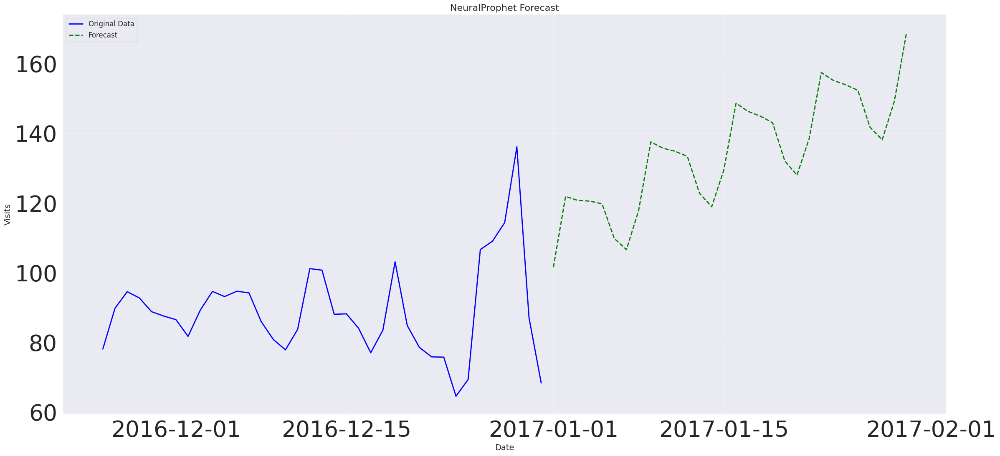

WARNING - (NP.plotting.log_warning_resampler_switch_to_valid_env) - Warning: plotly-resampler not supported for the environment you are using. Plotting backend automatically switched to 'plotly' without resampling 


In [ ]:
from neuralprophet import NeuralProphet
import matplotlib.pyplot as plt


df_prophet = df_changed.reset_index(drop=True)  


df_prophet.rename(columns={'date': 'ds', 'Visits': 'y'}, inplace=True)


model = NeuralProphet(
    yearly_seasonality=True, 
    weekly_seasonality=True,  
)


metrics = model.fit(df_prophet, freq="D")

n_steps_ahead = 30 


future = model.make_future_dataframe(df_prophet, periods=n_steps_ahead)


forecast = model.predict(future)


plt.figure(figsize=(25, 12))
plt.plot(df_prophet['ds'], df_prophet['y'], label="Original Data", color="blue", linewidth=2)
plt.plot(forecast['ds'], forecast['yhat1'], label="Forecast", color="green", linestyle="--", linewidth=2)


plt.title("NeuralProphet Forecast", fontsize=16)
plt.xlabel("Date", fontsize=14)
plt.ylabel("Visits", fontsize=14)
plt.legend(loc="upper left", fontsize=12)
plt.grid(alpha=0.3)
plt.tight_layout()
plt.show()

# Plot the NeuralProphet components (e.g., trend, seasonality)
model.plot_components(forecast)


WARNING - (NP.forecaster.fit) - When Global modeling with local normalization, metrics are displayed in normalized scale.
INFO - (NP.df_utils._infer_frequency) - Major frequency D corresponds to 97.297% of the data.
INFO:NP.df_utils:Major frequency D corresponds to 97.297% of the data.
INFO - (NP.df_utils._infer_frequency) - Defined frequency is equal to major frequency - D
INFO:NP.df_utils:Defined frequency is equal to major frequency - D
INFO - (NP.config.init_data_params) - Setting normalization to global as only one dataframe provided for training.
INFO:NP.config:Setting normalization to global as only one dataframe provided for training.
INFO - (NP.utils.set_auto_seasonalities) - Disabling daily seasonality. Run NeuralProphet with daily_seasonality=True to override this.
INFO:NP.utils:Disabling daily seasonality. Run NeuralProphet with daily_seasonality=True to override this.
INFO - (NP.config.set_auto_batch_epoch) - Auto-set batch_size to 8
INFO:NP.config:Auto-set batch_size to 8

Training: |          | 0/? [00:00<?, ?it/s]

WARNING - (NP.config.set_lr_finder_args) - Learning rate finder: The number of batches (5) is too small than the required number                     for the learning rate finder (203). The results might not be optimal.


Finding best initial lr:   0%|          | 0/203 [00:00<?, ?it/s]

Training: |          | 0/? [00:00<?, ?it/s]

INFO - (NP.df_utils._infer_frequency) - Major frequency D corresponds to 97.297% of the data.
INFO:NP.df_utils:Major frequency D corresponds to 97.297% of the data.
INFO - (NP.df_utils._infer_frequency) - Defined frequency is equal to major frequency - D
INFO:NP.df_utils:Defined frequency is equal to major frequency - D
INFO - (NP.df_utils.return_df_in_original_format) - Returning df with no ID column
INFO:NP.df_utils:Returning df with no ID column
INFO - (NP.df_utils._infer_frequency) - Major frequency D corresponds to 96.667% of the data.
INFO:NP.df_utils:Major frequency D corresponds to 96.667% of the data.
INFO - (NP.df_utils._infer_frequency) - Defined frequency is equal to major frequency - D
INFO:NP.df_utils:Defined frequency is equal to major frequency - D
INFO - (NP.df_utils._infer_frequency) - Major frequency D corresponds to 96.667% of the data.
INFO:NP.df_utils:Major frequency D corresponds to 96.667% of the data.
INFO - (NP.df_utils._infer_frequency) - Defined frequency is

Predicting: |          | 0/? [00:00<?, ?it/s]

INFO - (NP.df_utils.return_df_in_original_format) - Returning df with no ID column
INFO:NP.df_utils:Returning df with no ID column


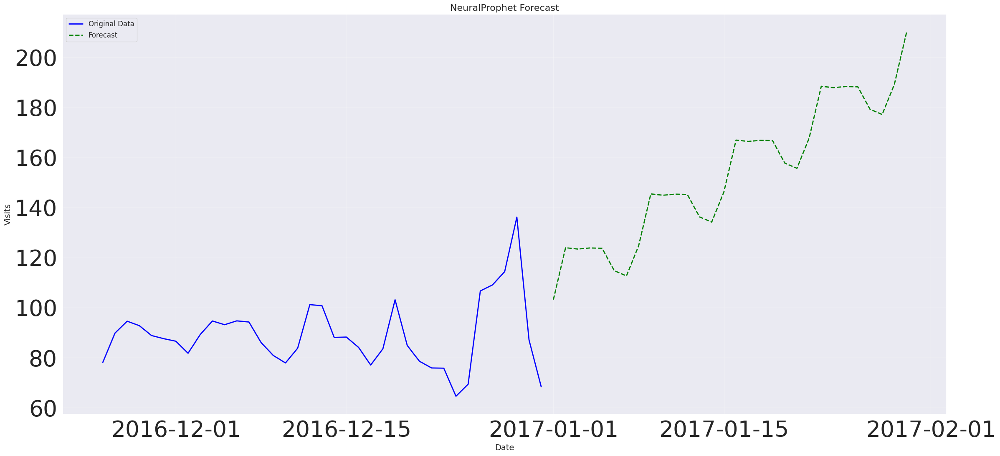

WARNING - (NP.plotting.log_warning_resampler_switch_to_valid_env) - Warning: plotly-resampler not supported for the environment you are using. Plotting backend automatically switched to 'plotly' without resampling 


In [ ]:
from neuralprophet import NeuralProphet
import matplotlib.pyplot as plt


df_prophet = df_changed.reset_index(drop=True)  


df_prophet.rename(columns={'date': 'ds', 'Visits': 'y'}, inplace=True)


model = NeuralProphet(
    yearly_seasonality=False,  
    weekly_seasonality=True,  
)


metrics = model.fit(df_prophet, freq="D")


n_steps_ahead = 30  


future = model.make_future_dataframe(df_prophet, periods=n_steps_ahead)


forecast = model.predict(future)


plt.figure(figsize=(25, 12))
plt.plot(df_prophet['ds'], df_prophet['y'], label="Original Data", color="blue", linewidth=2)
plt.plot(forecast['ds'], forecast['yhat1'], label="Forecast", color="green", linestyle="--", linewidth=2)


plt.title("NeuralProphet Forecast", fontsize=16)
plt.xlabel("Date", fontsize=14)
plt.ylabel("Visits", fontsize=14)
plt.legend(loc="upper left", fontsize=12)
plt.grid(alpha=0.3)
plt.tight_layout()
plt.show()


model.plot_components(forecast)


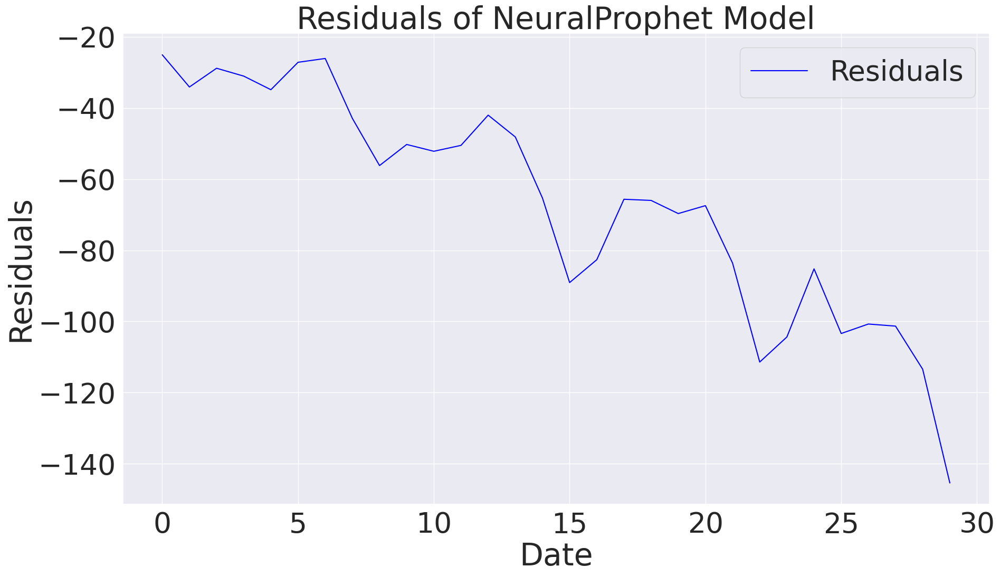

In [ ]:
plt.figure(figsize=(20, 12))
plt.plot(residuals, color='blue', label="Residuals")
plt.title("Residuals of NeuralProphet Model")
plt.xlabel("Date")
plt.ylabel("Residuals")
plt.grid(True)
plt.legend()
plt.tight_layout()
plt.show()


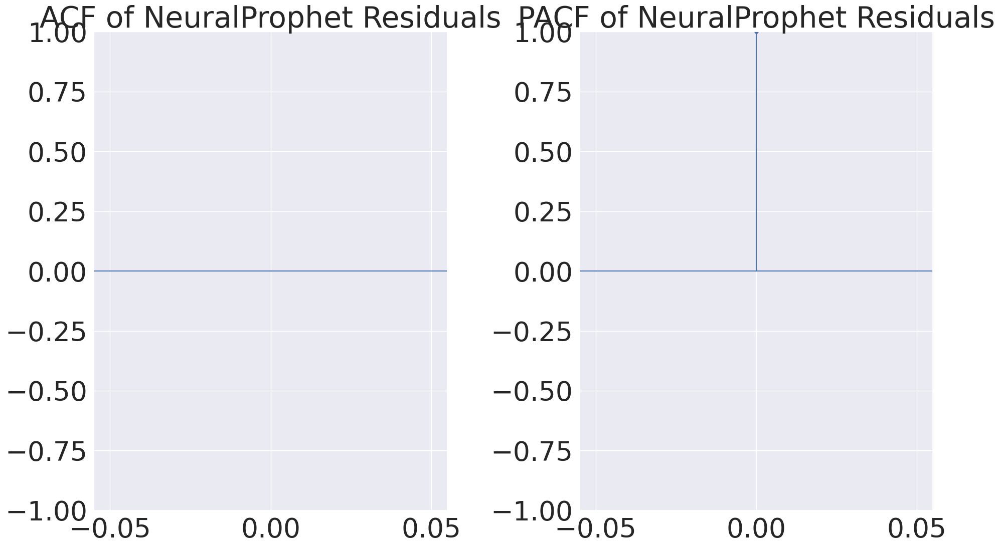

In [ ]:
y_true = df_prophet['y']
y_pred = forecast['yhat1'][:len(y_true)] 
residuals = y_true - y_pred
plt.figure(figsize=(20, 12))

plt.subplot(1, 2, 1)
plot_acf(residuals, lags=10, ax=plt.gca())
plt.title("ACF of NeuralProphet Residuals")


plt.subplot(1, 2, 2)
plot_pacf(residuals, lags=10, ax=plt.gca())
plt.title("PACF of NeuralProphet Residuals")

plt.tight_layout()
plt.show()

In [ ]:
actual_values = df_prophet['y'][-n_steps_ahead:]  
predicted_values = forecast['yhat1'][-n_steps_ahead:]  


rmse = np.sqrt(mean_squared_error(actual_values, predicted_values))
mae = mean_absolute_error(actual_values, predicted_values)


In [ ]:
print(f"RMSE: {rmse}")
print(f"MAE: {mae}")

RMSE: 78.08484997909473
MAE: 70.61745006730878


DEBUG:cmdstanpy:input tempfile: /tmp/tmp431jg8tx/6272_a9f.json
DEBUG:cmdstanpy:input tempfile: /tmp/tmp431jg8tx/ytpol5wb.json
DEBUG:cmdstanpy:idx 0
DEBUG:cmdstanpy:running CmdStan, num_threads: None
DEBUG:cmdstanpy:CmdStan args: ['/usr/local/lib/python3.10/dist-packages/prophet/stan_model/prophet_model.bin', 'random', 'seed=48304', 'data', 'file=/tmp/tmp431jg8tx/6272_a9f.json', 'init=/tmp/tmp431jg8tx/ytpol5wb.json', 'output', 'file=/tmp/tmp431jg8tx/prophet_modelsj0co31n/prophet_model-20241125083739.csv', 'method=optimize', 'algorithm=newton', 'iter=10000']
08:37:39 - cmdstanpy - INFO - Chain [1] start processing
INFO:cmdstanpy:Chain [1] start processing
08:37:39 - cmdstanpy - INFO - Chain [1] done processing
INFO:cmdstanpy:Chain [1] done processing


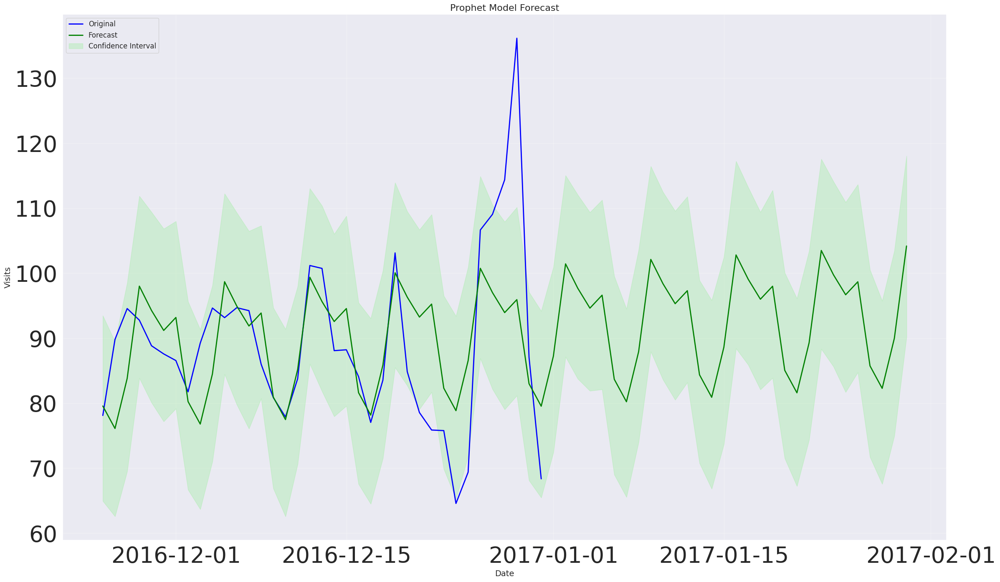

AIC: 191.74341638589792
BIC: 203.0198417744075


In [ ]:
from prophet import Prophet
from sklearn.metrics import mean_squared_error
import numpy as np
import pandas as pd
import matplotlib.pyplot as plt


df_prophet = df_date_index.reset_index()
df_prophet.rename(columns={'date': 'ds', 'Visits': 'y'}, inplace=True)

model = Prophet(yearly_seasonality=False, weekly_seasonality=True, daily_seasonality=False)
model.fit(df_prophet)


future = model.make_future_dataframe(periods=n_steps_ahead, freq='D')
forecast = model.predict(future)


plt.figure(figsize=(25, 15))
plt.plot(df_prophet['ds'], df_prophet['y'], color='blue', label='Original', linewidth=2)
plt.plot(forecast['ds'], forecast['yhat'], color='green', label='Forecast', linestyle='-', linewidth=2)

plt.fill_between(
    forecast['ds'],
    forecast['yhat_lower'],
    forecast['yhat_upper'],
    color='lightgreen',
    alpha=0.3,
    label='Confidence Interval'
)


plt.title('Prophet Model Forecast', fontsize=16)
plt.xlabel('Date', fontsize=14)
plt.ylabel('Visits', fontsize=14)
plt.legend(loc='upper left', fontsize=12)
plt.grid(alpha=0.3)
plt.tight_layout()
plt.show()


y_true = df_prophet['y']
y_pred = forecast.loc[:len(y_true)-1, 'yhat']
rss = np.sum((y_true - y_pred)**2)
n = len(y_true)
k = len(model.params)  

aic = n * np.log(rss / n) + 2 * k
bic = n * np.log(rss / n) + k * np.log(n)

print(f"AIC: {aic}")
print(f"BIC: {bic}")




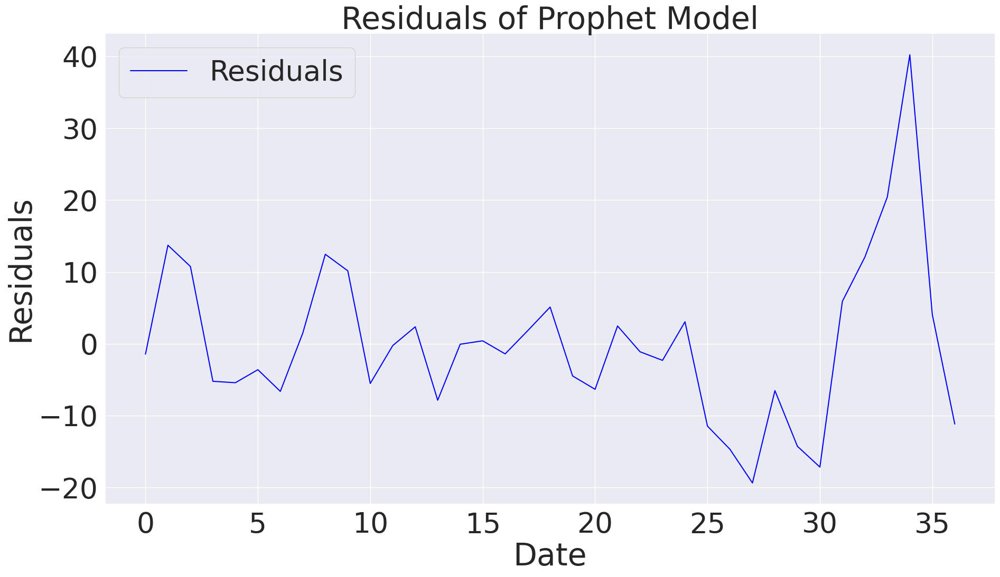

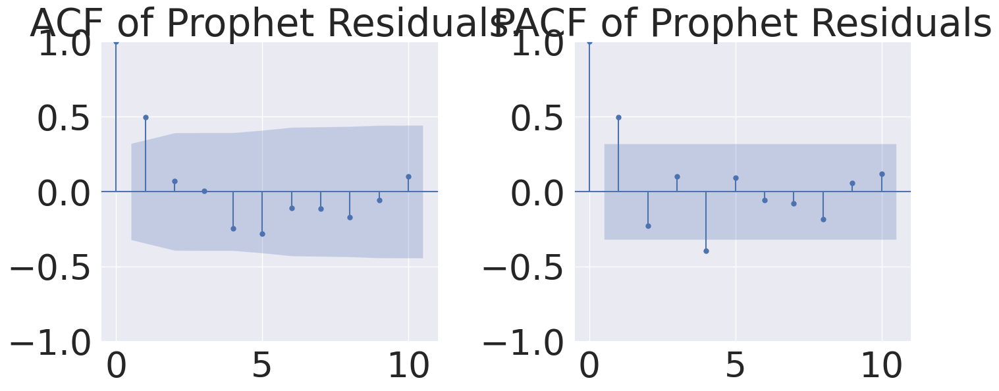

In [ ]:
y_true = df_prophet['y']
y_pred = forecast.loc[:len(y_true)-1, 'yhat']  
residuals = y_true - y_pred


plt.figure(figsize=(20, 12))
plt.plot(residuals, color='blue', label="Residuals")
plt.title("Residuals of Prophet Model")
plt.xlabel("Date")
plt.ylabel("Residuals")
plt.grid(True)
plt.legend()
plt.tight_layout()
plt.show()


plt.figure(figsize=(15, 7))


plt.subplot(1, 2, 1)
plot_acf(residuals, lags=10, ax=plt.gca())
plt.title("ACF of Prophet Residuals")


plt.subplot(1, 2, 2)
plot_pacf(residuals, lags=10, ax=plt.gca())
plt.title("PACF of Prophet Residuals")

plt.tight_layout()
plt.show()


rmse = np.sqrt(mean_squared_error(y_true, y_pred))
mae = mean_absolute_error(y_true, y_pred)

In [ ]:
rmse = np.sqrt(mean_squared_error(y_true, y_pred))
mae = mean_absolute_error(y_true, y_pred)


print(f"RMSE: {rmse}")
print(f"MAE: {mae}")

RMSE: 11.044560665110668
MAE: 7.916227454535694
